# Computer Vision - Assignment 3 - Feature Extraction and Image Stitching

#### 10 points   |   Due date: December 31, 23:59   |   Submission site: https://pradogrado2324.ugr.es/

### Student's Full Name: <mark>Juan Manuel Rodríguez Gómez</mark>



<font color='blue'>In this assignment you will learn:

<font color='blue'>a) to detect interest points using the Harris Corner Detector (Exercise 2) and a multi-scale approach to detect blobs using the Laplacian of Gaussian (Exercise 1).

<font color='blue'>b) to find correspondences between the keypoints from two images using descriptors (SIFT and Haralick) (Exercise 3).

<font color='blue'>c) to compose a rectangular mosaic/panorama from a bunch of images using homographies (Exercise 4).

In [1]:
from google.colab import drive
drive.mount('/content/drive', force_remount=True)
import sys,os
%cd '/content/drive/My Drive'
get_image = lambda route: os.path.join('/content/drive/MyDrive/images/', route)
import numpy as np
from matplotlib import pyplot as plt
import cv2

Mounted at /content/drive
/content/drive/My Drive


In [2]:
'''
This function receives a string with the filename of the image to read,
and a flag indicating if we want to read it in color/RGB (flagColor=1) or gray level (flagColor=0)

Example of use:
im1=readIm(get_image('apple.jpg'),0)

'''
def readIm(filename, flagColor=1):
  # cv2 reads BGR format
  im=cv2.imread(filename)
  # change to  RGB and return the image
  if(flagColor):
    return cv2.cvtColor(im, cv2.COLOR_BGR2RGB)
  # change from BGR to grayscale instead if flag is 0
  return cv2.cvtColor(im, cv2.COLOR_BGR2GRAY)

In [3]:
'''
This function receives an array of arbitrary real numbers (that could include even negative values),
and returns an 'image' in the range [0,1].
flag_GLOBAL allows the user to normalize the whole image (including all channels) or to normalize
each channel/band independently.
'''
def rangeDisplay01(im, flag_GLOBAL= True):
  im = im.astype(float)
  if flag_GLOBAL:
    im = (im - im.min())/(im.max() - im.min())
  else:
    # bands normalization
    for band in range(im.shape[2]):
      im[:, :, band] = (im[:, :, band] - im[:, :, band].min())/(im[:, :, band].max() - im[:, :, band].min())
      # Note: remember that, for plt.imshow with RGB data, the valid range is [0..1] for floats and [0..255] for integers.
  return im

In [4]:
'''
This function displays a single image, including a title, using a magnification factor.

Example of use:
im1=readIm(get_image('apple.jpg'),0)
displayIm(im1,'Manzana',0.5)

'''
def displayIm(im, title='Result',factor= 2):
  # First normalize range
  max=np.max(im)
  min=np.min(im)
  if min<0 or max>255:
    im=rangeDisplay01(im,flag_GLOBAL=True)
  if len(im.shape) == 3:
    # im es tribanda
    plt.imshow(im, cmap='jet')
  else:
    # im es monobanda
    plt.imshow(im, cmap='gray')
  figure_size = plt.gcf().get_size_inches()
  plt.gcf().set_size_inches(factor * figure_size)
  plt.title(title)
  plt.xticks([]), plt.yticks([]) # eliminamos numeración
  plt.show()

In [5]:
'''
This function displays multiple images (including a title and using a magnification factor)
of equal size. The input to the function is a list of images.

Example of use:
im1=readIm(get_image('apple.jpg'),1)
images = [im1,im1,im1]

displayMI_ES(images, title='Manzanas',factor=1)

'''
def displayMI_ES(vim, title='Result',factor=2):
  # We set the maximun number of images to concatenate by columns
  maxcolumns=3
  # number of images to display
  numberim=len(vim)
  # The simplest case, one row: the maximum number of columns is larger than the images to stack
  # This is, by default, we put together the images column-wise
  if len(vim) < maxcolumns:
    out=vim[0]
    for item in range(1,len(vim)):
      #displayIm(out,str(item),1)
      out=np.hstack((out,vim[item]))

  # Else, if maxcolumns is smaller or equal than the number of images to stack
  else:
    # We check if all rows and columns are going to be 'busy', or if otherwise we need an extra-row
    if np.mod(len(vim),maxcolumns)== 0:
      maxrows=numberim//maxcolumns
    else:
      maxrows=numberim//maxcolumns+1

    # we build up the first block-row
    out=vim[0]
    for item in range(1,maxcolumns):
      out=np.hstack((out,vim[item]))
    # We build up the rest of block-rows
    for block in range(1,maxrows):
      #print(block)
      row=vim[block*maxcolumns]
      for item in range(1,maxcolumns):
        # We still have images to stack
        if block*maxcolumns+item < numberim:
          row=np.hstack((row,vim[block*maxcolumns+item]))
        # We do not have more images, and we have to fill with black
        else:
          row=np.hstack((row,np.zeros(vim[0].shape,dtype=vim[0].dtype)))
          #print(row.dtype)
          # if we don't include ',dtype=vim[0].dtype', np.zeros will include float
          # numbers in the matrix. This will make that the whole matrix will be
          # considered as floats, and values larger than 1 will be clipped to 1,
          # displaying an almost totally white image
      # add the new block-row
      out=np.vstack((out,row))
  return displayIm(out,title,factor)

In [6]:
# Here you include your functions from P1 to compute derivatives and convolution
def GaussFunc(x, sigma):
  '''
  Esta función implementa la función gaussiana
  Nota: Se ignora la constante que multiplica a la exponencial
  '''
  return np.exp( - x**2 /(2* sigma**2))

def GaussDeriv1Func(x, sigma):
  '''
  Esta función implementa la primera derivada de la función gaussiana
  '''
  return GaussFunc(x,sigma) * (-x / sigma**2)

def GaussDeriv2Func(x, sigma):
  '''
  Esta función implementa la segunda derivada de la función gaussiana
  '''
  return GaussDeriv1Func(x,sigma) * (-x / sigma**2) + GaussFunc(x,sigma) * (-1 / sigma**2)

def Mask(f, sizeMask):
  '''
  Esta función devuelve la máscara 'f' de tamaño 'sizeMask'
  '''
  k = (sizeMask - 1) // 2
  return [f(i) for i in range(-k, k + 1)]

def DeductSizeMaskFromSigma(sigma):
  '''
  Esta función calcula el tamaño de máscara a partir del valor de sigma
  '''
  return int((2 * np.floor(3*sigma)) + 1)

def DeductSigmaFromSizeMask(sizeMask):
  '''
  Esta función calcula el valor de sigma a partir del tamaño de máscara
  Nota: Se supone que supone que floor(3 * sigma) = 3 * sigma
  '''
  return (sizeMask - 1) / 6.0

def calculateGaussMask(sigma, sizeMask, order):
  '''
  Esta función calcula la máscara gaussiana de tamaño 'sizeMask' y orden 'order'
  '''
  # Máscara Gaussiana (Filtro Paso Bajo)
  if(order == 0):
    unnormalizedMask = np.array(
      Mask(lambda x: GaussFunc(x, sigma), sizeMask),
      np.float64
    )
    # Dividimos cada coeficiente por la suma de todos ellos para que sumen 1
    suma = sum(unnormalizedMask)
    normalizedMask = unnormalizedMask/suma
    return normalizedMask
  # Máscara de la Primera Derivada Gaussiana (Filtro Paso Alto)
  elif(order == 1):
    # Escalamos/Normalizamos multiplicando por 'sigma'
    mask = np.array(
      Mask(lambda x: sigma * GaussDeriv1Func(x, sigma), sizeMask),
      np.float64
    )
    return mask
  # Máscara de la Segunda Derivada Gaussiana (Filtro Paso Alto)
  elif(order == 2):
    # Escalamos/Normalizamos multiplicando por 'sigma'**2
    mask = np.array(
      Mask(lambda x: sigma**2 * GaussDeriv2Func(x, sigma), sizeMask),
      np.float64
    )
    return mask

def gaussianMask1D(sigma=0, sizeMask=0, order=0):
  '''
  Esta función calcula y devuelve la máscara gaussiana de tamaño 'sizeMask' y orden 'order'
  Requisito: 'sigma' debe ser mayor o igual que 0.
  Requisito: 'order' debe ser 0, 1 o 2.
  Requisito: No puede darse que 'sigma' y 'sizeMask' sean 0 a la vez
              (al menos unos de ellos debe ser distinto de cero)
  '''
  # Comprobación de requisitos
  assert sigma >= 0
  assert 0 <= order <= 2
  assert sigma != 0 or sizeMask != 0

  # Deducciones (en el caso de que fueran necesarias)
  if(sizeMask == 0):
    # Deducir 'sizeMask' a partir de 'sigma'
    sizeMask = DeductSizeMaskFromSigma(sigma)
  elif(sigma == 0):
    # Deducir 'sigma' a partir de 'sizeMask'
    sigma = DeductSigmaFromSizeMask(sizeMask)

  # Máscara Gaussiana de orden 'order'
  mask = calculateGaussMask(sigma, sizeMask, order)

  return mask

def my2DConv(im, sigma, orders):
  '''
  Esta función devuelve el resultado de convolucionar una imagen con:
      - Una Gaussiana (orders == [0,0])
              - Una Gaussiana (orders == [0,0])
              - La Primera Derivada de la Gaussiana
                tanto en X (orders == [1,0]) como en Y (orders == [0,1])
              - La Segunda Derivada de la Gaussiana
                tanto en X (orders == [2,0]) como en Y (orders == [0,2])
  Requisito: 'sigma' debe ser mayor o igual que 0.
  '''
  ddepth = cv2.CV_64F
  maskG = gaussianMask1D(sigma, order=0)
  maskDG = gaussianMask1D(sigma, order=1)
  mask2DG = gaussianMask1D(sigma, order=2)
  if orders==[0,0]: # Suavizado Gaussiano
    return cv2.sepFilter2D(im, ddepth, maskG, maskG)
  elif orders==[1,0]: # Convolución con la Primera Derivada Gaussiana en X
    return cv2.sepFilter2D(im, ddepth, maskDG, maskG)
  elif orders==[0,1]: # Convolución con la Primera Derivada Gaussiana en Y
    return cv2.sepFilter2D(im, ddepth, maskG, maskDG)
  elif orders==[2,0]: # Convolución con la Segunda Derivada Gaussiana en X
    return cv2.sepFilter2D(im, ddepth, mask2DG, maskG)
  elif orders==[0,2]: # Convolución con la Segunda Derivada Gaussiana en Y
    return cv2.sepFilter2D(im, ddepth, maskG, mask2DG)
  else:
    print('error in order of derivative')

def LaplacianOfGaussian(im, sigma):
  '''
  Esta función devuelve la Laplaciana de la Gaussiana para una imagen 'im' dada
  '''
  ddepth = cv2.CV_64F
  maskG = gaussianMask1D(sigma, order=0)
  mask2DG = gaussianMask1D(sigma, order=2)

  # Convolución en la dirección del eje X con la derivada segunda de la Gaussiana
  # y, luego, en la dirección del eje Y, convolución con la Gaussiana.
  dxx = cv2.sepFilter2D(im, ddepth, mask2DG, maskG)
  # Convolución en la dirección del eje Y con la derivada segunda de la Gaussiana
  # y, luego, en la dirección del eje X, convolución con la Gaussiana.
  dyy = cv2.sepFilter2D(im, ddepth, maskG, mask2DG)

  return dxx + dyy

# <font color='blue'>**Exercise 1:** Multi-scale blob detection using the Laplacian of Gaussian (2 points)

<font color='blue'> Students must implement a multiscale blob detector in Python that, based on successive applications of Laplacian of Gaussian (LoG) filters, allows them to identify interest points/regions. The process to follow is detailed below:

> <font color='blue'>1) use the following sigmas to create the corresponding scales: 11 values starting from $\sigma_0 = 0.5$ and increase $\sigma$ by a factor of 1.5. In other words, $\sigma=[0.5, 0.75, 1.125, 1.687, 2.531, 3.796, 5.695, 8.542, 12.814, 19.221, 28.832]$. Remember to convolve the image with scale-normalized LoG.

> <font color='blue'>2) Find maxima of squared Laplacian response in scale-space. Select the local maximum corresponding to a neighborhood $3\times3\times3$, where the central pixel of this volume would be the position to evaluate. That is, each pixel is compared with its 26 neighbors and saved if it is a maximum. The function `maximum_filter` from `scipy.ndimage` may be useful here. Along with this, also use a $\textit{threshold}$ to limit the number of blobs detected to around 1000 points.

> <font color='blue'>3) Draw the detected blobs as circles centered on the identified Cartesian coordinates, and radius proportional to the scale at which the corresponding blob was detected.

<font color='blue'>The process is visually shown on slide 63 of https://pradogrado2324.ugr.es/pluginfile.php/234073/mod_folder/content/0/3.3.BoW_Blobs.pdf

Por una parte, encontramos el término **"blob" (Binary Large OBject)**, el cual se define como un grupo de píxeles conectados en una imagen que comparten alguna propiedad común. En Visión por Computador, un blob suele referirse a una región de interés que es más ligera o más oscura que el fondo. La detección de blobs se utiliza a menudo para identificar y extraer información sobre objetos en una imagen.

Por otra parte, tenemos el término **"detección multiescala"**, el cual es un enfoque que busca identificar características de una imagen a diferentes escalas o niveles de resolución. Esto es importante porque las características de una imagen pueden aparecer de diferentes tamaños y formas cuando se observan a diferentes distancias o resoluciones. Utilizando un enfoque multiescala, un detector de blobs puede identificar objetos que serían demasiado grandes o pequeños si solo se analizara la imagen a una sola escala.

Para la detección de bordes y blobs, se suele utilizar el operador **Laplaciana de la Gaussiana** ya que sirve para resaltar regiones de una imagen donde hay cambios rápidos en la intensidad. Recordemos su expresión matemática:

$$L = \sigma^2 ( G_{xx}(x,y,\sigma) + G_{yy}(x,y, \sigma)),$$

donde:

$$G(x) = \frac{1}{\sigma \sqrt{2 \pi}} e^{-\frac{x^2}{2 \sigma^2}}$$  

 es la función Gaussiana con media $\mu = 0$ para todo $x \in \mathbb{R}$.

 Este filtro combina dos operaciones importantes: el suavizado mediante un filtro Gaussiano para reducir el ruido y la detección de bordes mediante el operador Laplaciano. La multiplicación por $\sigma^2$ sirve para escalar/normalizar la máscara, pero a la hora de la implementación no lo hemos puesto en la función `LaplacianOfGaussian()` ya que esta normalización ya se introdujo en la función `calculateGaussMask()`. Lo más destacable del filtro LoG es que, debido al suavizado previo con el filtro Gaussiano, es capaz de detectar bordes a diferentes escalas en la imagen. Dicho \sigma controla el grado de suavizado: **un sigma pequeño proporciona menos suavizado, útil para detectar blobs pequeños, mientras que un sigma grande proporciona más suavizado, útil para detectar blobs más grandes.** Al variar sigma y buscar máximos locales en el espacio de escala, el detector puede identificar blobs a diferentes escalas.

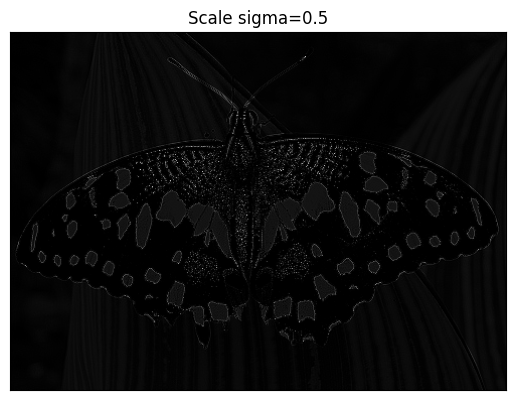

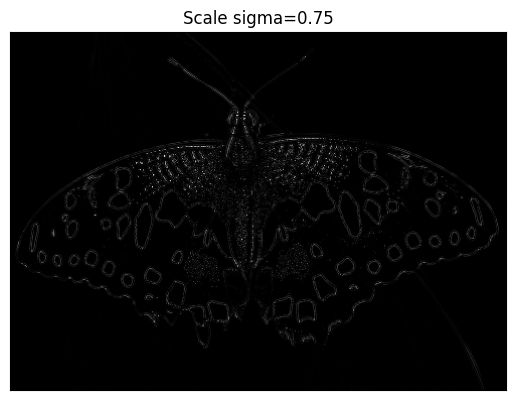

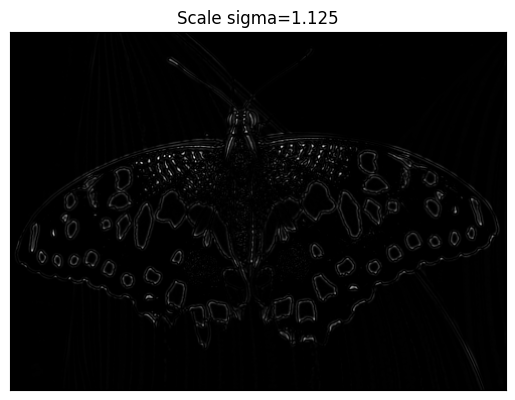

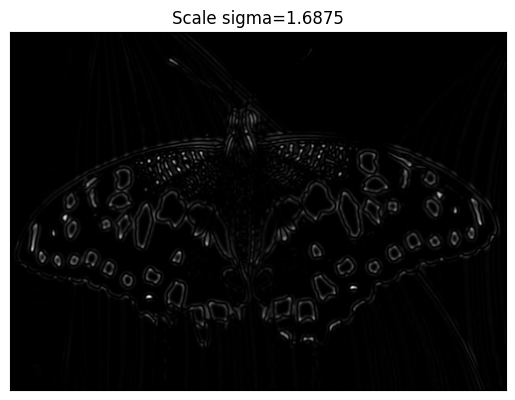

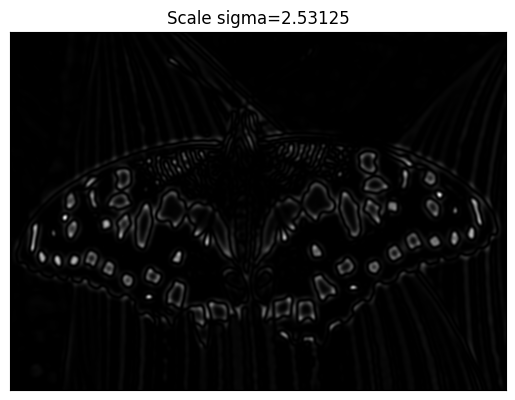

...

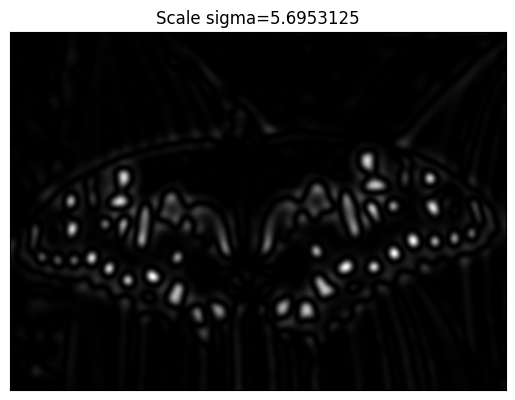

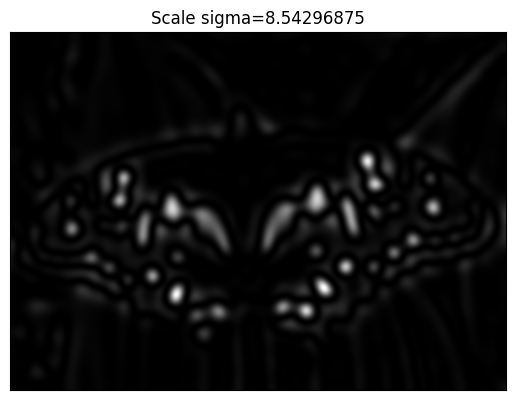

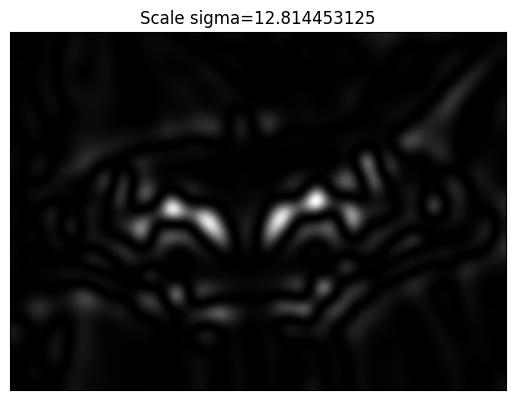

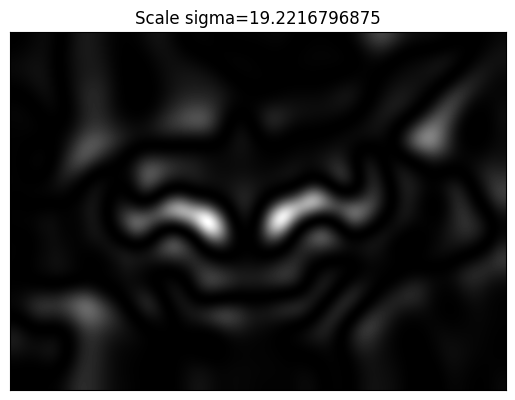

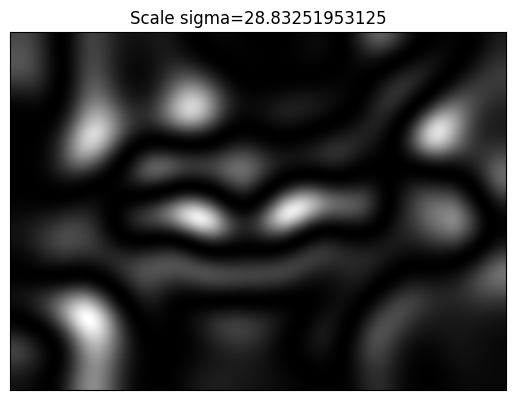

In [7]:
# Leer la imagen y convertirla a escala de grises
im = readIm(get_image('butterfly.jpg'), 0)

# Inicialización de los diferentes sigmas que van a definir el espacio de escalas
# Generar 11 valores de sigma, comenzando desde 0.5 y aumentando cada valor por un factor de 1.5
sigmas = [0.5 * (1.5**i) for i in range(11)]

# Espacio de escalas
scaleSpace = []

# Convolucionar la imagen con LoG normalizada a escala para las diferentes escalas
for sigma in sigmas:
  # Aplicar la Laplaciana de la Gaussiana (LoG) a la imagen en la escala actual
  # y elevar la respuesta al cuadrado (no se diferencia entre máximos y mínimos.
  # Elevando al cuadrado, solo hay que buscar máximos)
  LoGim = LaplacianOfGaussian(im, sigma)**2

  # Visualizar la imagen resultante para la escala actual
  displayIm(rangeDisplay01(LoGim, True), title='Scale sigma='+str(sigma), factor=1)

  # Añadir la imagen convolucionada al espacio de escalas
  scaleSpace.append(LoGim)

# Apilar todas las imágenes del espacio de escalas para formar un "cubo" 3D
# Cada "capa" del cubo representa la respuesta de LoG en una escala diferente
scaleSpace = np.stack(scaleSpace, axis=-1)

Después de aplicar el filtro LoG, se busca en la imagen los **puntos donde la respuesta al filtro es un **máximo local**. Esto significa que el valor de la respuesta del filtro en ese punto es mayor que en todos los píxeles vecinos (en un vecindario 3x3x3 en el espacio de escala, habiendo así 26 píxeles vecinos). Estos máximos locales suelen corresponder a los centros de los blobs. Para realizar esta operación usamos la función `maximum_filter()` del módulo `ndimage` de la biblioteca SciPy.

[1] https://docs.scipy.org/doc/scipy/reference/generated/scipy.ndimage.maximum_filter.html

También utilizamos un **umbral** para asegurarnos de que solo se detectan blobs significativos y se limita el número de blobs detectados. Esto ayuda a descartar falsos positivos o variaciones menores que no son de interés. Queremos detectar alrededor de 1000 blobs.

Finalmente, una vez identificados **los blobs, se dibujan como círculos en la imagen**, con el centro en las coordenadas detectadas y el radio proporcional a la escala en la que se detectó el blob. Esto permite visualizar dónde y a qué escala se han detectado los blobs en la imagen.

**NOTA:** La detección de blobs es, comúnmente, una etapa previa a la extracción de características tras crear una ventana centrada en el blob detectado. Desde este punto de vista, detectar blobs en los bordes (es decir, blobs incompletos) no tiene demasiado sentido porque no tendríamos espacio dentro de la imagen para extraer las features asociadas. En mi código, precisamente por este motivo, **elimino aquellos blobs que no quepan completamente en la imagen.**

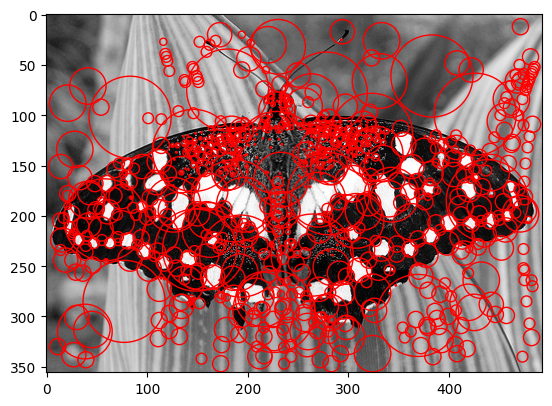


Número de Blobs Detectados:  1004


In [8]:
from scipy.ndimage import maximum_filter

# Encontrar los máximos locales en el espacio de escalas 3D usando un vecindario de 3 x 3 x 3
localMaxs = maximum_filter(scaleSpace, size=(3,3,3)) == scaleSpace  # Si es un máximo (local) en su vecindad, es True. En otro caso, es False.

# Definir un umbral (threshold) para limitar el número de blobs detectados
# Dicho umbral se calcula como el percentil 94 de los valores en las posiciones de máximos locales
threshold = np.percentile(scaleSpace[localMaxs], 94)

# Filtrar los máximos locales según el umbral definido
# Solo se mantienen los puntos que son máximos locales y cuyos valores son mayores que el umbral
localMaxsThresholded = np.logical_and(localMaxs, scaleSpace > threshold)

# Obtener las coordenadas (y, x) y la escala (sigma) de los blobs detectados
blobsCoordsY, blobsCoordsX, scaleSigmas = np.where(localMaxsThresholded)

# Blobs que se mantienen dentro de los límites de la imagen
filteredBlobs = []

for i in range(len(blobsCoordsX)):
  blobX = blobsCoordsX[i]                  # Coordenada X del blob
  blobY = blobsCoordsY[i]                  # Coordenada Y del blob
  blobSigma = 0.5 * (1.5**scaleSigmas[i])  # Sigma (escala) del blob
  radius = blobSigma * np.sqrt(2)          # Radio para dibujar el blob (proporcional a su sigma)

  # Verificar si el blob está demasiado cerca del borde de la imagen
  if (blobX - radius >= 0 and blobY - radius >= 0 and
    blobX + radius < im.shape[1] and blobY + radius < im.shape[0]):
    # Si el blob está completamente dentro de los límites de la imagen, añadirlo a la lista filtrada
    filteredBlobs.append((blobX, blobY, radius))

# Visualización de la imagen y sus blobs detectados (tras el filtrado)
fig, ax = plt.subplots()
ax.imshow(im, cmap='gray')  # Imagen en escala de grises

# Dibujar cada blob filtrado en la imagen con un círculo rojo (a mayor radio, mayor escala en la que se ha detectado dicho blob)
for blobX, blobY, radius in filteredBlobs:
    circle = plt.Circle((blobX, blobY), radius, color='red', fill=False, linewidth=1)
    ax.add_patch(circle)

# Mostrar la imagen con los blobs
plt.show()

print('\nNúmero de Blobs Detectados: ', len(filteredBlobs))

Observamos que se han detectado 1004 blobs. Muchos de los centros  de los círculos vemos que coinciden con puntos de interés visual en la imagen como, por ejemplo, las manchas en las alas de la mariposa.

Como ya comentamos, el radio de cada círculo es proporcional a la escala ($\sigma$) en la que se detectó el blob.Observamos círculos grandes, los cuales corresponden a características que son más prominentes a escalas mayores (objetos más grandes o patrones), así como círculos más pequeños, los cuales corresponden a características que son más evidentes a escalas menores (detalles finos).

Una alta densidad de blobs en una región puede indicar una textura compleja o un patrón repetitivo. Esto ocurre, por ejemplo, en las pequeñas manchas de las alas que se encuentran cerca de la cabeza de la mariposa, la cual siguen un patrón repetitivo, acumulándose así muchos blobs con un radio pequeño en dicha zona. También observamos que se produce una gran superposición de blobs (esto puede ser un indicador de que el umbral utilizado para la detección de máximos locales no era lo suficientemente alto, lo que lleva a múltiples detecciones para la misma característica en diferentes escalas).

Finalmente, observamos regiones con muy pocos blobs detectados o incluso sin ellos. Esto ocurre, tal y como se esperaba, en el fondo de la imagen ya que es un área sin características distintivas. El mayor número de blobs detectados se encuentran en la mariposa, como era de esperar.

## **1.1. Comparación con `skimage.feature.blob_log()`**

Vamos a usar la función `blob_log()` del módulo `feature` de la biblioteca scikit-image para realizar la detección de blobs multiescala mediante la Laplaciana de la Gaussiana de la misma forma que lo hemos implementado anteriormente. Cabe destacar que con el parámetro `exclude_border = True` en dicha función, eliminamos aquellos blobs que no quepan completamente en la imagen.

[2] https://scikit-image.org/docs/stable/api/skimage.feature.html#skimage.feature.blob_log

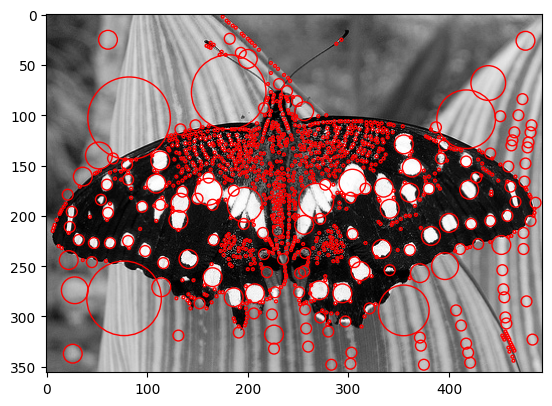


Número de Blobs Detectados:  1064


In [9]:
from skimage.feature import blob_log

# Detectar los blobs de la imagen utilizando la Laplaciana de la Gaussiana
blobs = blob_log(im, min_sigma=1, max_sigma=29, num_sigma=11, threshold=0.11, exclude_border=True)

# Visualización de la imagen y sus blobs detectados
fig, ax = plt.subplots()
ax.imshow(im, cmap='gray')  # Imagen en escala de grises

for blob in blobs:
  blobY, blobX, blobSigma = blob    # Coordenada X, coordenada Y y sigma (escala) del blob
  radius = blobSigma * np.sqrt(2)   # Radio para dibujar el blob (proporcional a su sigma)

  # Dibujar cada blob filtrado en la imagen con un círculo rojo (a mayor radio, mayor escala en la que se ha detectado dicho blob)
  circle = plt.Circle((blobX, blobY), radius, color='red', fill=False, linewidth=1)
  ax.add_patch(circle)

# Mostrar la imagen con los blobs
plt.show()

print('\nNúmero de Blobs Detectados: ', len(blobs))

Observamos una detección de blobs más "limpia" y precisa se podría decir, Ya no se produce apenas superposición de blobs y se están detectando blobs en las regiones esperadas (manchas de las alas de la mariposa sobre todo). Vemos que esta función realiza una mejor detección de blobs que la que hemos implementado nosotros.

# <font color='blue'>**Exercise 2:** Harris Corner Detector (3 points)

<font color='blue'>Write the Python code necessary to implement the detection of the stronger 100-150 Harris points in an image. The steps to implement the Harris corner detector are the following: \


> <font color='blue'>a) Set the derivative ($\sigma_D$) and integration scales ($\sigma_I$) to 1.5 and 2.25, respectively. Other sigma values can also be employed if the student considers that it improves performance.



> <font color='blue'>b) Compute the image derivatives.

> <font color='blue'>c) Compute the three terms of the second moment matrix ($SMM$) at each pixel. To do it, apply convolution with a Gaussian mask with $\sigma_I$.

> <font color='blue'>d) Compute the Harris value at each pixel of the image (discard pixels/points close to the edges).

> <font color='blue'>e) Apply Non-Maxima Suppression by using the function `corner_peaks()` (https://scikit-image.org/docs/stable/api/skimage.feature.html#skimage.feature.corner_peaks) from the module `skimage.features`. The student must select a suitable `min_distance` (`minimal allowed distance separating peaks`), and a suitable response threshold in the Harris Map to just keep the number of keypoints we need (100-150). The output will be a list of $(x,y)$ coordinates. Extract the values in these coordinates and create a list of vectors $(x,y,value)$.

> <font color='blue'>f) Compute the main orientation for each point. This is done by smoothing both derivative images with a sufficiently large sigma ($\sigma=3$) and computing the orientation of the gradient at those points.

> <font color='blue'>d) Create a list of KeyPoints using the selected points. A KeyPoint is a vector including $(x,y,scale,orientation)$. A KeyPoint is an OpenCV's structure (`cv2.KeyPoint`), associated to each detected region,  necessary to call OpenCV feature extractor algorithms.

> <font color='blue'>e) Draw the keypoints on the image using the function `drawKeyPoints()` (https://docs.opencv.org/4.x/d4/d5d/group__features2d__draw.html#ga5d2bafe8c1c45289bc3403a40fb88920), and flags `cv2.DRAW_MATCHES_FLAGS_DRAW_OVER_OUTIMG+cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS`.


El **detector de esquinas de Harris** es un algoritmo popular en el campo de Visión por Computador para detectar esquinas y discontinuidades en las imágenes. Es ampliamente utilizado en diversas aplicaciones como el seguimiento de características, el reconocimiento de objetos y la construcción de panoramas.

Las **esquinas** definen como puntos en la imagen con variaciones significativas de intensidad en todas las direcciones (a diferencia de una región plana, donde no hay variaciones en ninguna dirección, y los bordes, donde no hay variaciones solo a lo largo de la dirección del eje del borde). Son puntos de interés porque son invariables a la rotación, la escala y la iluminación, lo que los hace ideales para el seguimiento y reconocimiento de características.

En el detector de Harris se utiliza la **Second Moment Matrix (SMM)**. Esta matriz es una representación cuadrática de las diferencias de intensidad de una ventana alrededor de cada píxel. Se calcula utilizando las derivadas de la imagen en las direcciones x e y. También se suele aplicar un suavizado gaussiano a cada componente de dicha matriz. Matemáticamente, dicha matriz sería de la forma:

$$H(u,v) = \left( \begin{array}{cc}
\sum_{W} w(x,y) \partial I_{x}^2 & \sum_{W} w(x,y) \partial I_{x} \partial I_{y} \\
\sum_{W} w(x,y)  \partial I_{x} \partial I_{y} & \sum_{W} w(x,y) \partial I_{y}^2
\end{array} \right)
$$

donde:

- $\partial I_{x}^2$ es la derivada de la imagen respecto de X.
- $\partial I_{y}^2$ es la derivada de la imagen respecto de Y.
- $\sum_{W} w(x,y)$ es un suavizado gaussiano de sigma $\sigma_{I}$.

Una vez calculada la SMM, calculamos su determinante y su traza. Haciendo la siguiente operación:

$$f_{H} = \frac{det(H)}{trace(H)},$$

obtenemos un valor para cada píxel de la imagen (**Mapa de Harris**). Con esta medida de Harris evaluamos la variación de la intensidad para una ventana de píxeles desplazada en varias direcciones. Obtendríamos un valor alto en las esquinas y bajo en bordes y superficies planas.

Los **pasos para implementar el detector de esquinas de Harris** son los siguientes:

1. Escalas de derivación e integración: Los sigmas $\sigma_{D}$ y $\sigma_{I}$ determinan el suavizado Gaussiano utilizado sobre la imagen antes de calcular las derivadas y el suavizado posterior, respectivamente. Estos valores pueden ajustarse para mejorar la detección en diferentes escalas. En nuestro caso, $\sigma_{D} = 1.5$ y $\sigma_{I} = 1.5 * \sigma_{D} = 2.25$.

2. Derivadas de la imagen: Se calculan para obtener posteriormente la matriz de segundo momento, que requiere las derivadas en dirección x e y. Usamos aquí el $\sigma_{D}$.

3. Matriz de segundo momento (SMM): Se calcula en cada píxel y se suaviza con un filtro Gaussiano para integrar las contribuciones de los píxeles vecinos. Usamos aquí el $\sigma_{I}$.

4. Mapa de Harris: Se calcula utilizando el determinante y la traza de la SMM para evaluar si un píxel podría ser una esquina.

5. Supresión de No Máximos: Se aplica para asegurar que cada esquina se detecte una sola vez y para eliminar las respuestas de Harris débiles que están cerca de una respuesta más fuerte. Para ello, utilizamos la función `corner_peaks()` del módulo `feature` de la biblioteca scikit-image. Elegimos valores adecuados de `min_distance` y `threshold_abs` como parámetros de dicha función para obtener entre 100 y 150 keypoints.

    [3] https://scikit-image.org/docs/stable/api/skimage.feature.html#skimage.feature.corner_peaks

6. Orientación principal: Se calcula para cada punto de interés suavizando las imágenes de derivada con un sigma suficientemente grande ($\sigma = 3$) y calculando la orientación del gradiente en esos puntos.

7. Lista de KeyPoints: Un KeyPoint es un vector que incluye las coordenadas, la escala y la orientación. Estos se usan en algoritmos de extracción de características. A partir de los puntos de interés detectados anteriormente, creamos una lista de KeyPoints. Para crear un KeyPoint, utilizamos la función `cv2.KeyPoint()` de la biblioteca OpenCV.

    [4] https://docs.opencv.org/3.4/d2/d29/classcv_1_1KeyPoint.html#a9d81b57ae182dcb3ceac86a6b0211e94

8. Dibujo de los KeyPoints: Visualizamos las esquinas detectadas sobre la imagen original. Para ello, utilizamos la función `cv2.drawKeypoints()` de la biblioteca OpenCV con el flag `cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS` para que se dibuje también la orientación y el tamaño en el círculo de cada KeyPoint.

    [5] https://docs.opencv.org/4.x/d4/d5d/group__features2d__draw.html#ga5d2bafe8c1c45289bc3403a40fb88920


El detector de Harris es conocido por su simplicidad y efectividad, aunque en aplicaciones modernas a menudo es reemplazado o complementado por algoritmos más avanzados como SIFT (el cual veremos en el ejercicio 3) que son invariantes a la escala y la rotación (**el detector de Harris no es invariante a la escala**).

In [10]:
# Función para calcular las derivadas de la imagen
def derivatives(im, sigmaD):
  # Convertir la imagen a float32 para operaciones de punto flotante
  im = im.astype(np.float32)

  # Derivada en dirección x
  dx = my2DConv(im, sigmaD, [1,0])
  # Derivada en dirección y
  dy = my2DConv(im, sigmaD, [0,1])

  return dx, dy

# Función para calcular el mapa de criterio de Harris
def HarrisMap(dx, dy, sigmaI):
  Ix = my2DConv(dx**2, sigmaI, [0,0])       # Término Ix^2 de la SMM
  Iy = my2DConv(dy**2, sigmaI, [0,0])       # Término Iy^2 de la SMM
  IxIy = my2DConv(dx * dy, sigmaI, [0,0])   # Término IxIy de la SMM

  detH = Ix * Iy - IxIy**2  # Determinante de la matriz de Harris
  traceH = Ix + Iy          # Traza de la matriz de Harris

  # Mapa de Harris
  HMap = detH / traceH

  return HMap

In [11]:
# Función para aplicar la Supresión de No Máximos en el mapa de Harris
def NonMaximaSuppression(harrisMap, min_distance, threshold):
  # Utilizar corner_peaks para encontrar picos (candidatos a ser esquinas) en el mapa de Harris
  points = corner_peaks(harrisMap, min_distance, threshold_abs = threshold)

  # Almacenar los valores de Harris de las coordenadas detectadas, así como dichas coordenadas
  coord = points    # Coordenadas de los picos detectados
  values = []
  for p in coord:
    values.append(harrisMap[p[0], p[1]])  # Valores del mapa de Harris en los picos detectados

  return coord, values

In [12]:
# Función para calcular el mapa de orientaciones de la imagen
def orientation(dx, dy):
  # Derivadas suavizadas en las direcciones x e y, respectivamente
  smooth_dx = my2DConv(dx, 3.0, [0,0])
  smooth_dy = my2DConv(dy, 3.0, [0,0])

  # Orientación del gradiente en cada punto de la imagen (convertida de radianes a grados)
  theta = np.arctan2(smooth_dy, smooth_dx) * (180 / np.pi)

  return theta

# Función para crear una lista de objetos KeyPoint a partir de listas de coordenadas, orientaciones y escalas
def keyPoints(coord, theta, size):
  # Lista de keypoints
  keyPoints = []

  for p in coord:
    # Obtener la orientación para el keypoint actual
    angle = theta[p[0], p[1]]
    # Crear un objeto KeyPoint con las coordenadas x, y, un tamaño predeterminado y el ángulo calculado
    kp = cv2.KeyPoint(float(p[1]), float(p[0]), float(size), angle)    # Nota: p[1] corresponde a x, p[0] corresponde a y
    # Añadir el keypoint a la lista
    keyPoints.append(kp)

  return keyPoints

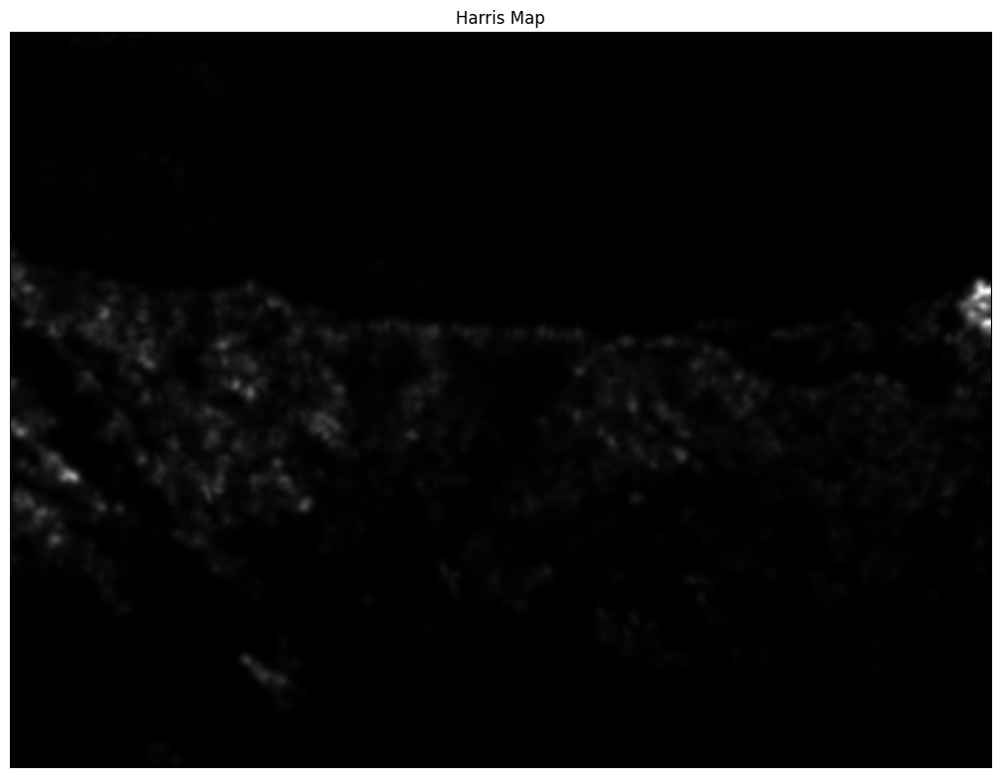

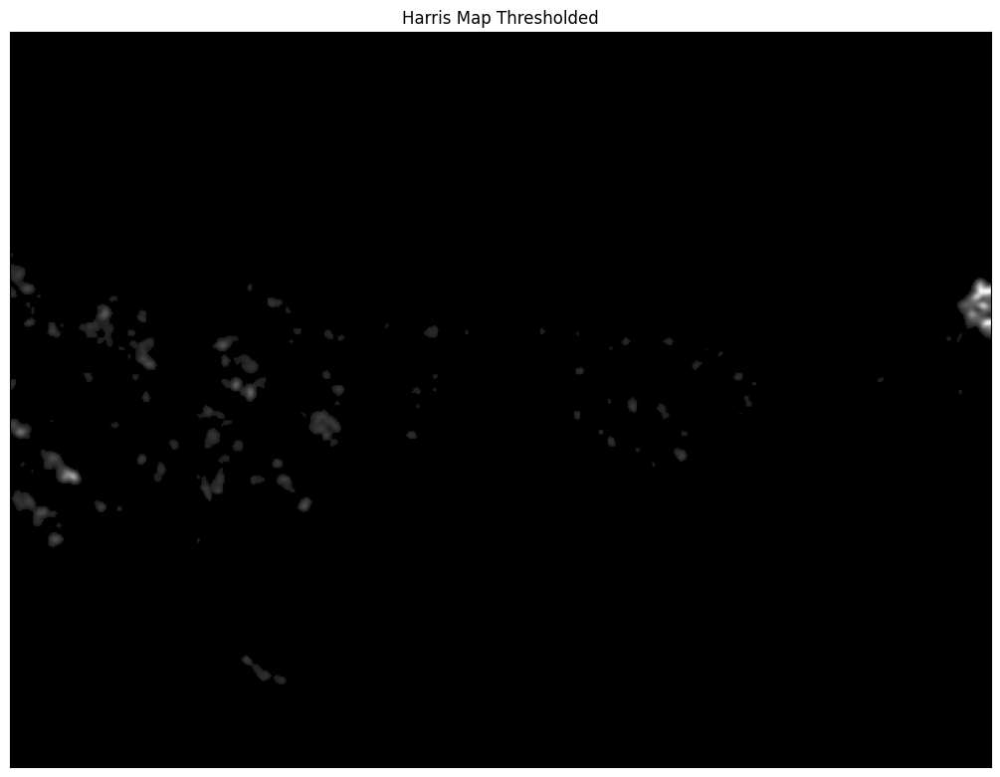

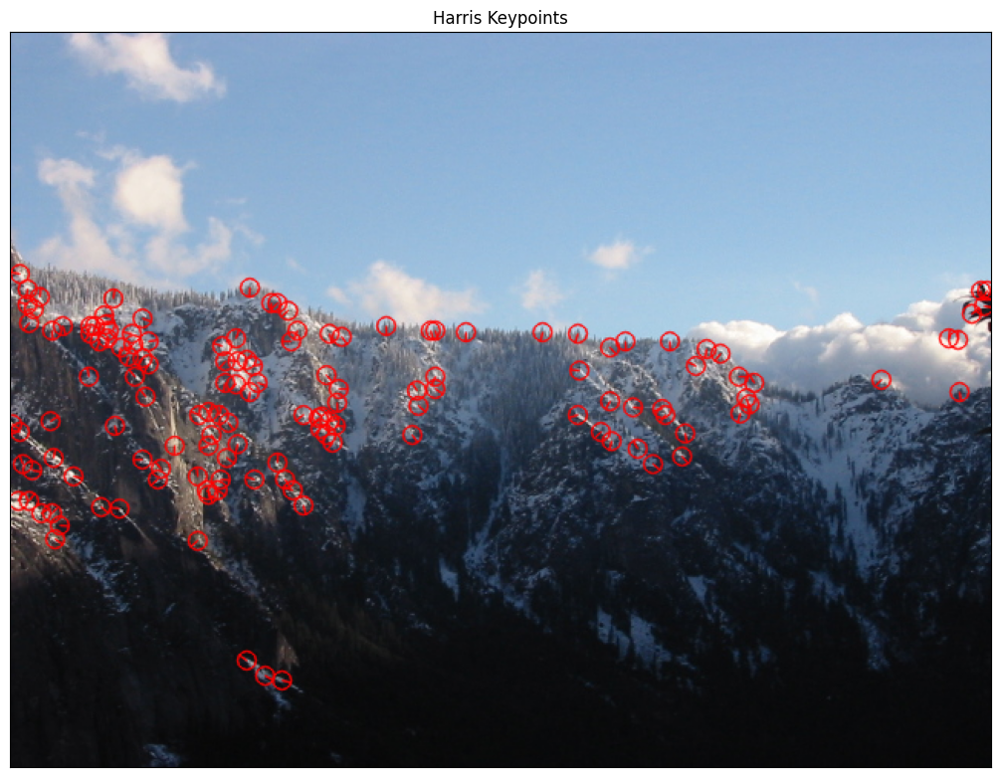


Número de Keypoints Detectados:  141


In [13]:
# Vamos a calcular los keypoints de Harris y a mostrarlos

from skimage.feature import corner_peaks

# Leer la imagen a color y convertirla a escala de grises
img = readIm(get_image('yosemite7.jpg'), 1)
im = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)

# Calcular las derivadas de la imagen en escala de grises
sigmaD = 1.5
dx, dy = derivatives(im, sigmaD)

# Calcular el mapa de criterio de Harris
sigmaI = 1.5 * sigmaD
harrisMap = HarrisMap(dx, dy, sigmaI)

# Aplicar Supresión de No Máximos
min_distance = 1             # Distancia mínima entre puntos
threshold = 650              # Umbral
coord, values = NonMaximaSuppression(harrisMap, min_distance, threshold)

# Umbralización del mapa de Harris
harrisMapThresholded = harrisMap.copy()

for i in range(harrisMapThresholded.shape[0]):
  for j in range(harrisMapThresholded.shape[1]):
    if harrisMapThresholded[i, j] < threshold:
      harrisMapThresholded[i, j] = 0

# Calcular el mapa de orientaciones
theta = orientation(dx, dy)

# Lista de KeyPoints
size = 12                             # Tamaño predeterminado
kps = keyPoints(coord, theta, size)

# Dibujar los keypoints en la imagen a color
harrisKeypoints = cv2.drawKeypoints(img, kps, None, color=(255,0,0), flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

# Visualización de imágenes
displayIm(rangeDisplay01(harrisMap, True), title='Harris Map', factor=2)
displayIm(rangeDisplay01(harrisMapThresholded, True), title='Harris Map Thresholded', factor=2)
displayIm(rangeDisplay01(harrisKeypoints, True), title='Harris Keypoints', factor=2)

print('\nNúmero de Keypoints Detectados: ', len(kps))

En la imagen `Harris Map` se observan como zonas blancas aquellos puntos de interés que se han detectado como esquinas.

Tras la supresión de no máximos, podemos observar en la imagen `Harris Map Thresholded` que aquellos puntos de interés con una respuesta débil que se encontraban cerca de puntos de interés con una respuesta más fuerte (un valor más alto), desaparecen.

Finalmente, en la imagen `Harris Keypoints`, podemos observar las esquinas detectadas ya dibujadas en la imagen del paisaje montañoso. Se ha obtenido un total de 141 esquinas detectadas. En una imagen con dicho paisaje, se espera que las esquinas detectadas se encuentren en los bordes de las montañas y donde el cielo se encuentra con las cimas de las montañas. Podemos observar que dichas esquinas detectadas se encuentran justo en las zonas mencionadas, tal y como se esperaba. Un indicador de que no se estuviese haciendo la detección correctamente sería que se detectaran esquinas en el cielo (el cual es una región plana), pero vemos que esto no está ocurriendo.

## **2.1. Comparación con `skimage.feature.corner_harris()`**

Vamos a usar la función `corner_harris()` del módulo `feature` de la biblioteca scikit-image para realizar la detección de esquinas de Harris de la misma forma que lo hemos implementado anteriormente.

[6] https://scikit-image.org/docs/stable/api/skimage.feature.html#skimage.feature.corner_harris

Cabe destacar también que en nuestra implementación usábamos un threshold con un valor de 650, mientras que ahora usamos un valor de 0.05. Esta gran diferencia de valores se debe a que los valores proporcionados por el Harris Map en nuestra implementación (los cuales se encuentran en un rango alto) y los de la función `corner_harris()` (los cuales se encuentran en un rango bajo) se encuentran en rangos muy diferentes debido a cómo se calculan. Por ello, es importante tener cuidado a la hora de elegir dichos valores como el del threshold.

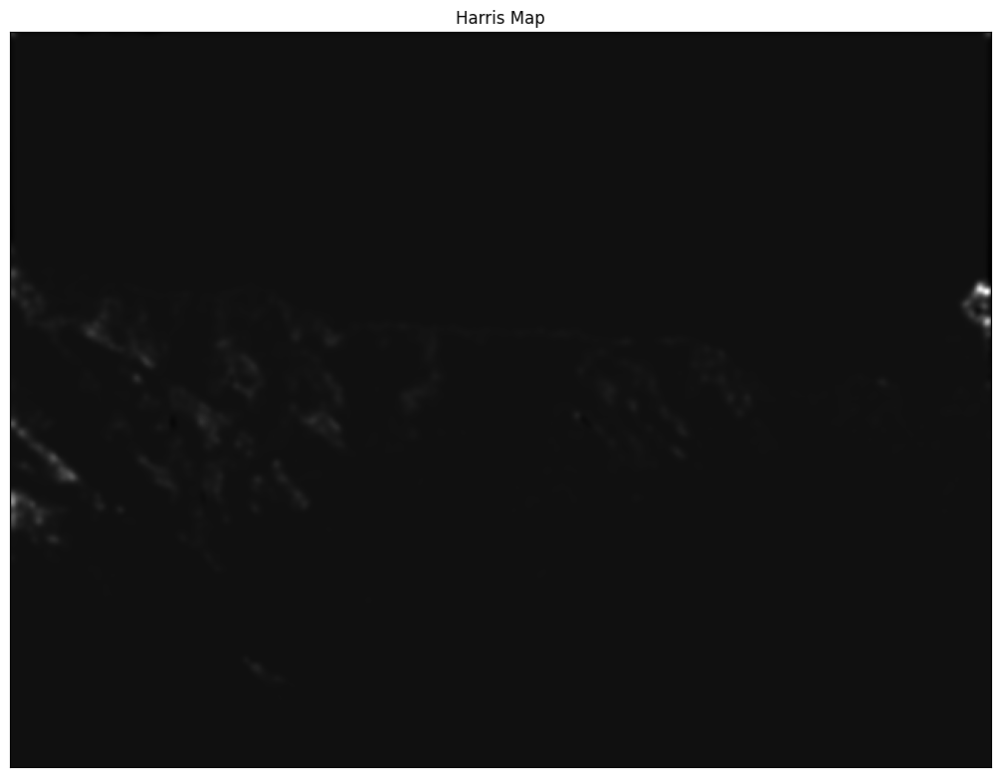

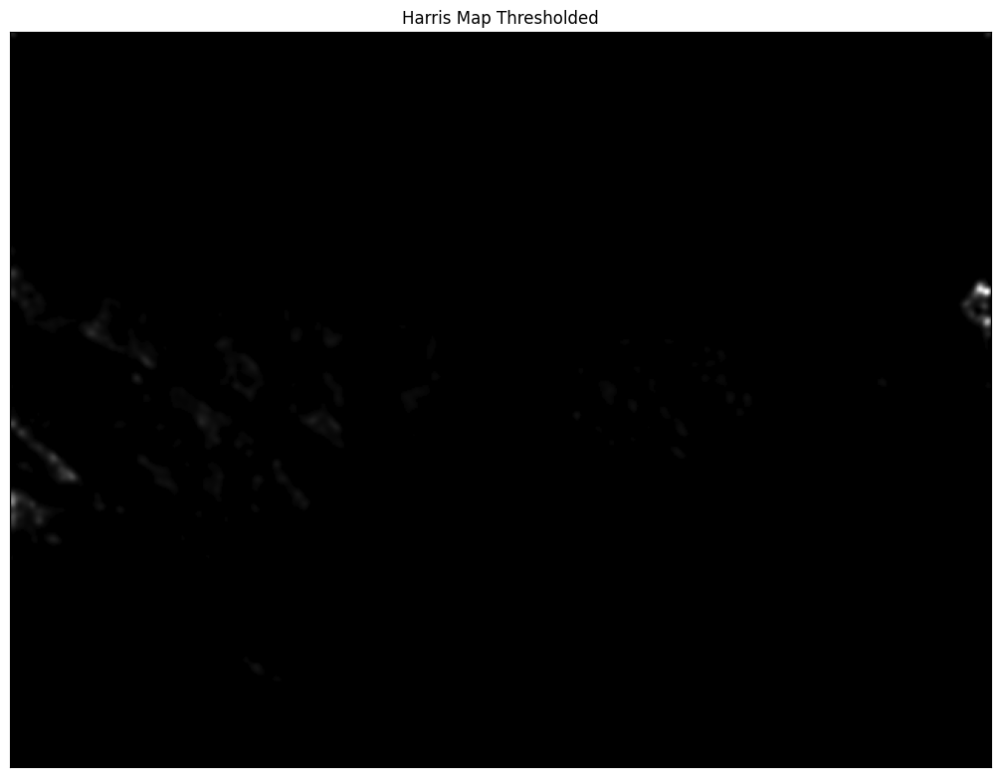

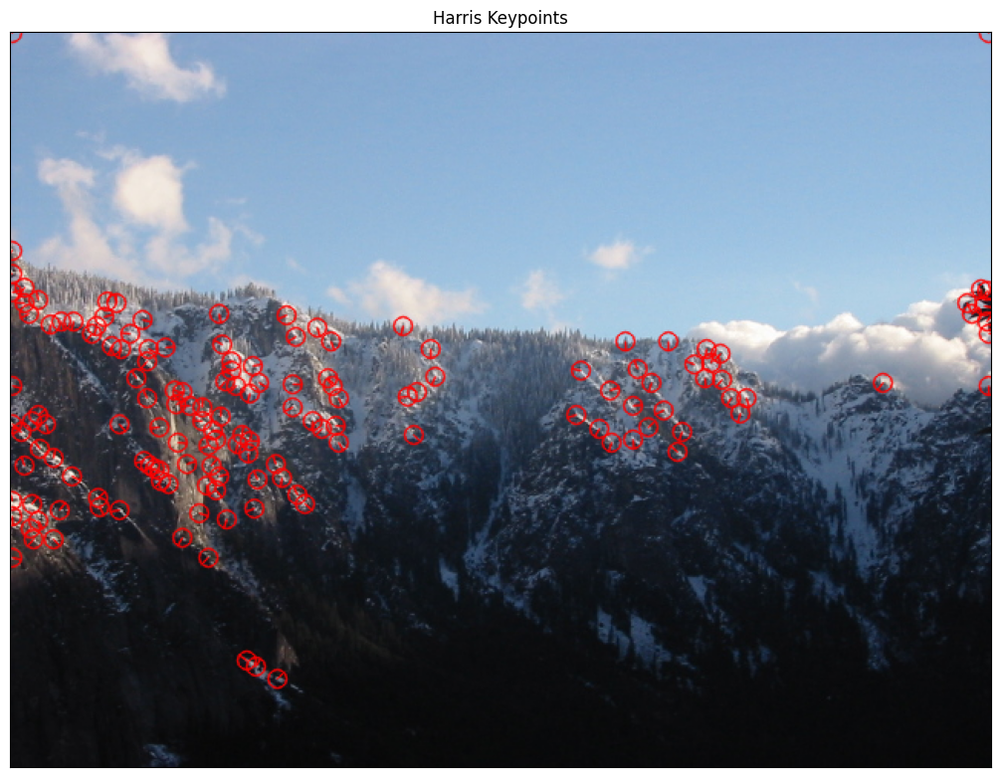


Número de Keypoints Detectados:  150


In [14]:
# Vamos a calcular los keypoints de Harris y a mostrarlos

from skimage.feature import corner_harris
from skimage.feature import corner_peaks

# Leer la imagen a color y convertirla a escala de grises
img = readIm(get_image('yosemite7.jpg'), 1)
im = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)

# Calcular las derivadas de la imagen en escala de grises
sigmaD = 1.5
dx, dy = derivatives(im, sigmaD)

# Calcular el mapa de criterio de Harris
sigmaI = 1.5 * sigmaD
harrisMap = corner_harris(im, sigma=sigmaI)

# Aplicar Supresión de No Máximos
min_distance = 1             # Distancia mínima entre puntos
threshold = 0.05             # Umbral
coord, values = NonMaximaSuppression(harrisMap, min_distance, threshold)

# Umbralización del mapa de Harris
harrisMapThresholded = harrisMap.copy()

for i in range(harrisMapThresholded.shape[0]):
  for j in range(harrisMapThresholded.shape[1]):
    if harrisMapThresholded[i, j] < threshold:
      harrisMapThresholded[i, j] = 0

# Calcular el mapa de orientaciones
theta = orientation(dx, dy)

# Lista de KeyPoints
size = 12                             # Tamaño predeterminado
kps = keyPoints(coord, theta, size)

# Dibujar los keypoints en la imagen a color
harrisKeypoints = cv2.drawKeypoints(img, kps, None, color=(255,0,0), flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

# Visualización de imágenes
displayIm(rangeDisplay01(harrisMap, True), title='Harris Map', factor=2)
displayIm(rangeDisplay01(harrisMapThresholded, True), title='Harris Map Thresholded', factor=2)
displayIm(rangeDisplay01(harrisKeypoints, True), title='Harris Keypoints', factor=2)

print('\nNúmero de Keypoints Detectados: ', len(kps))

Vemos que los resultados obtenidos usando la función `corner_harris()` son prácticamente idénticos a los resultados obtenidos usando nuestro código implementado.

# <font color='blue'>**Exercise 3:** Matching keypoints between images using SIFT and Haralick descriptors (2 points)

<font color='blue'>Write the Python code necessary to compute the matching between points from two images. To do so, you have to apply the SIFT algorithm to both images in order to extract keypoints and descriptors (see https://docs.opencv.org/3.4/dc/dc3/tutorial_py_matcher.html). Then, we use the Brute-Force cross-check criterion (`cv2.BFMatcher`) and Lowe's ratio distance criterion (`knnMatch`) to compute the matches and draw the best 100 matches using the function `cv2.drawMatches`.

**Scale-Invariant Feature Transform (SIFT)** es un algoritmo de Visión por Computador para detectar y describir características locales en imágenes. Fue publicado por David Lowe en 2004 y desde entonces se ha convertido en uno de los algoritmos más utilizados debido a su robustez y eficacia.

El proceso de SIFT consta de varias etapas clave:

1. Detección de puntos extremos en el espacio de escala: SIFT comienza buscando puntos extremos en una imagen a través de múltiples escalas. Esto se hace utilizando la diferencia de imágenes gaussianas (DoG) para identificar posibles puntos de interés que son invariantes a la escala.

2. Localización de puntos clave: Los puntos extremos detectados son refinados para obtener ubicaciones más precisas. Esto incluye la eliminación de puntos de bajo contraste (poco probables de ser características distintivas).

3. Asignación de orientaciones: A cada punto clave se le asigna una o más orientaciones basadas en gradientes locales de la imagen. Esto hace que las características sean invariantes a la rotación.

4. Generación de descriptores de puntos clave: En esta etapa, se crea un descriptor para cada punto clave. El descriptor es esencialmente un vector que resume la información de gradiente local alrededor del punto clave, de manera que es invariante a rotaciones y parcialmente invariante (robusto podríamos decir) a cambios de iluminación y perspectiva. SIFT proporciona un descriptor con 128 valores.

Para usar SIFT, disponemos de la función `cv2.SIFT_create()` en la biblioteca OpenCV. Una vez tengamos el objeto de la clase SIFT, utilizaríamos el método `detectAndCompute()` para obtener los keypoints y los descriptores de la imagen correspondiente.

[7] https://docs.opencv.org/4.x/d7/d60/classcv_1_1SIFT.html

[8] https://docs.opencv.org/4.x/da/df5/tutorial_py_sift_intro.html

In [15]:
# Función para calcular keypoints y descriptores en una imagen usando SIFT
def siftPoints(im, nfeatures=5000):
  # Inicializar el detector SIFT
  sift = cv2.SIFT_create(nfeatures=nfeatures)

  # Encontrar los keypoints y descriptores con SIFT
  kp, ds = sift.detectAndCompute(im, None)

  return kp, ds

Una vez obtenidos los puntos clave y los descriptores de las imágenes utilizando SIFT, procederíamos con el **emparejamiento de los puntos de interés entre las dos imágenes**. Para ello, se utilizan distintos métodos para encontrar las correspondencias más confiables entre los descriptores de puntos clave generados por el algoritmo en cuestión (SIFT en nuestro caso). Dos métodos comunes para este emparejamiento son el criterio Brute-Force con cross-check y el criterio de distancia de Lowe, que se usa en el emparejamiento K-Nearest Neighbors (KNN).

El **Brute-Force Matcher** es un enfoque directo que compara cada descriptor en la primera imagen con todos los descriptores en la segunda imagen y encuentra el mejor emparejamiento basado en la distancia de los descriptores. Para hacer dicha comparación, usamos la distancia $L_{2}$. Aquella comparación con menor distancia es la que se acaba seleccionando, realizándose así los matches entre los puntos de ambas imágenes. Con este método, podemos obtener distancias pequeñas para matches ambiguos/incorrectos. Por ello, añadimos una verificación adicional llamada **cross-check**. Si cross-check está habilitado, el emparejamiento solo se considera válido si el punto A en la primera imagen es el mejor emparejamiento para el punto B en la segunda imagen, y el punto B es también el mejor emparejamiento para el punto A (un match se considera válido solo si obtenemos el mismo par de keypoints en ambas direcciones, es decir, cada keypoint es el mejor match del otro). Esto ayuda a eliminar muchos falsos positivos, ya que asegura una correspondencia mutua entre los puntos. También puede ser más lento porque hace comparaciones exhaustivas, y el cross-check requiere un doble chequeo. Para aplicarlo, creamos un objeto de la clase BFMatcher con la función `cv2.BFMatcher(cv2.NORM_L2, crossCheck = True)` y, tras ello, utilizamos el método `match()`.

[9] https://docs.opencv.org/4.x/d3/da1/classcv_1_1BFMatcher.html

Por otro lado, tenemos también el **algoritmo KNN** para emparejar, se buscan los k vecinos más cercanos para cada descriptor, donde k típicamente es 2. Esto significa que para cada descriptor de la primera imagen, se buscan los dos emparejamientos más cercanos en la segunda imagen. Lowe sugirió un método (**test de ratio de Lowe**) para distinguir entre buenos y malos emparejamientos utilizando la relación entre las distancias del vecino más cercano y del segundo vecino más cercano. Si la distancia al vecino más cercano es significativamente menor que la distancia al segundo vecino más cercano (usualmente se utiliza un umbral de 0.75), entonces el emparejamiento se considera bueno. Esto se debe a que un buen emparejamiento debe ser sustancialmente mejor que cualquier otro emparejamiento incorrecto. Es más eficiente en términos computacionales que el Brute-Force Matcher con cross-check, especialmente para bases de datos grandes de descriptores. Para aplicarlo, creamos un objeto de la clase BFMatcher con la función `cv2.BFMatcher(cv2.NORM_L2, crossCheck = False)` y, tras ello, utilizamos el método `knnMatch()` con `k = 2` y  aplicamos el test de ratio de Lowe con un umbral de 0.75.

[10] https://docs.opencv.org/3.4/dc/dc3/tutorial_py_matcher.html

Si nos preguntamos, cuál de los dos métodos de matching es mejor, la respuesta es que depende. Si la precisión es la prioridad y los datos no son excesivamente grandes, el método Brute-Force con Cross-Check puede ser preferible debido a su robustez. Para conjuntos de datos más grandes o cuando se necesita velocidad y se pueden tolerar algunos falsos positivos, Lowe's Ratio Test con KNN Matching es a menudo más adecuado.

En la práctica, es aconsejable probar ambos métodos en tus datos y decidir cuál produce los mejores resultados para nuestra aplicación específica. Además, la elección puede ser influenciada por la cantidad de ruido en tus datos, la cantidad de puntos clave y descriptores, y las características específicas de las imágenes que estás tratando de emparejar.

Una vez calculados los matches, los ordenamos de menor a mayor distancia y nos quedamos con los N primeros (los mejores) matches (en nuestro caso, `N = 100`) Finalmente, **dibujamos estos matches** con la función `cv2.drawMatches()`.

[11] https://docs.opencv.org/4.x/d4/d5d/group__features2d__draw.html#gad8f463ccaf0dc6f61083abd8717c261a



In [16]:
# Función para mostrar los keypoints de una imagen
def showKP(im, kp, title):
  # Dibujar los keypoints en la imagen
  img = cv2.drawKeypoints(im, kp, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

  # Mostrar la imagen con los keypoints dibujados
  displayIm(img, title, 1)

# Función para mostrar los emparejamientos (matches) entre dos imágenes
def showMatches(im1, kp1, im2, kp2, matches, N, title='Matches'):
  # Dibujar los emparejamientos entre las dos imágenes
  imBF = cv2.drawMatches(im1, kp1, im2, kp2, matches[:N], None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

  # Mostrar la imagen con los emparejamientos dibujados
  displayIm(imBF, title, 2)

# Función para emparejar descriptores entre dos conjuntos de descriptores
def matching(ds1, ds2, FlagMode='BF'):
  if FlagMode == 'BF':
    # Crear un objeto BFMatcher para el emparejamiento Brute-Force con crossCheck
    bf = cv2.BFMatcher(cv2.NORM_L2, crossCheck = True)

    # Realizar emparejamientos
    matches = bf.match(ds1, ds2)

    # Ordenar los emparejamientos basados en la distancia para que los mejores emparejamientos aparezcan primero
    matches = sorted(matches, key=lambda x: x.distance)

    return matches

  elif FlagMode == 'KNN':
    # Crear un objeto BFMatcher para el emparejamiento KNN
    bf = cv2.BFMatcher(cv2.NORM_L2, crossCheck = False)

    # Realizar emparejamiento KNN con K = 2
    knnMatches = bf.knnMatch(ds1, ds2, k=2)

    # Aplicar el test de ratio de Lowe para encontrar buenos emparejamientos
    good = []
    for m, n in knnMatches:
        if (m.distance / n.distance) < 0.75:
            good.append(m)

    # Ordenar los emparejamientos basados en la distancia para que los mejores emparejamientos aparezcan primero
    good = sorted(good, key=lambda x: x.distance)

    return good

  else:
      return print('Error in Matching mode')

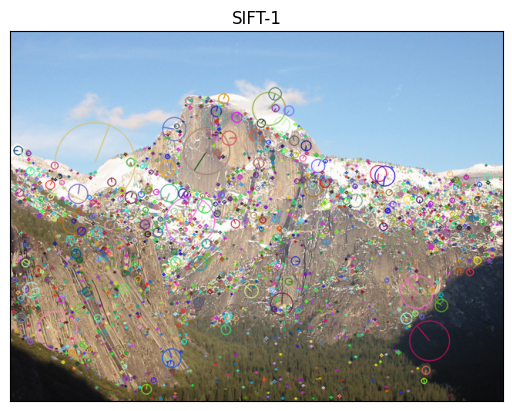

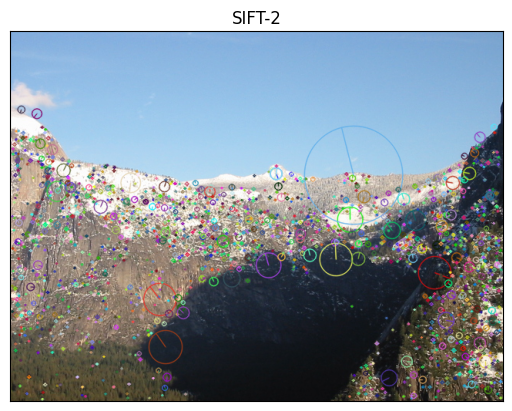

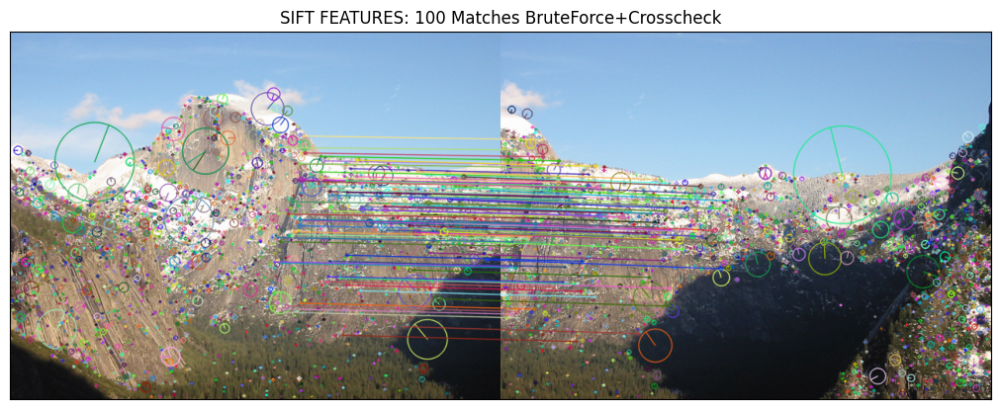

In [17]:
# Leer dos imágenes y convertirlas a escala de grises
img1 = readIm(get_image('yosemite2.jpg'), 1)
im1 = cv2.cvtColor(img1, cv2.COLOR_RGB2GRAY)

img2 = readIm(get_image('yosemite3.jpg'), 1)
im2 = cv2.cvtColor(img2, cv2.COLOR_RGB2GRAY)

# Detectar keypoints y calcular descriptores para ambas imágenes en escala de grises
kp1, ds1 = siftPoints(im1)
kp2, ds2 = siftPoints(im2)

# Mostrar los keypoints detectados en ambas imágenes a color
showKP(img1, kp1, 'SIFT-1')
showKP(img2, kp2, 'SIFT-2')

# Emparejar los descriptores entre las dos imágenes usando Brute-Force con crossCheck
matchesBF = matching(ds1, ds2, FlagMode='BF')

# Mostrar los N primeros emparejamientos entre ambas imágenes a color
N = 100
showMatches(img1, kp1, img2, kp2, matchesBF, N, title='SIFT FEATURES: 100 Matches BruteForce+Crosscheck')

Observamos que tenemos un buen emparejamiento, ya que las líneas que conectan los puntos clave entre las dos imágenes son consistentes en términos de dirección y flujo (es decir, las líneas no se cruzan de manera significativa y siguen la geometría natural de la escena).

No se observan emparejamientos donde las líneas conecten puntos que obviamente no son correspondientes, como, por ejemplo, conectar el cielo de una imagen con la montaña en la otra.

Visualmente, vemos que los puntos emparejados son correctos (es el mismo punto visto desde otra perspectiva).

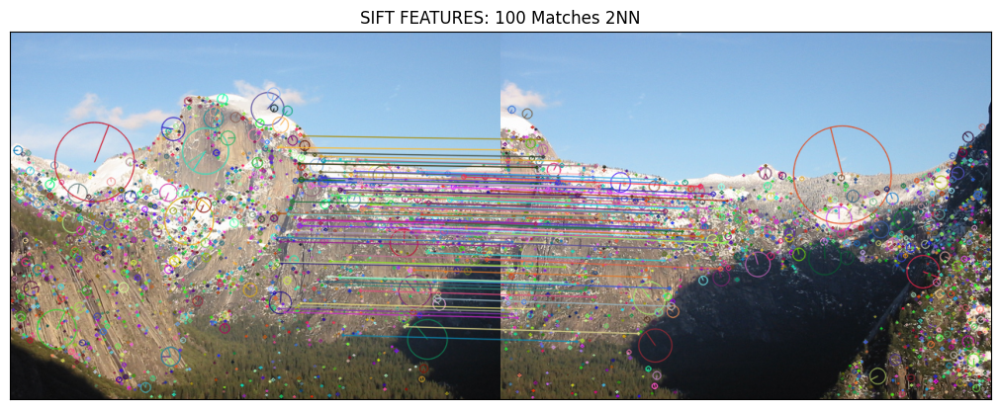

In [18]:
# Emparejar los descriptores entre las dos imágenes usando KNN con K = 2
matches2NN = matching(ds1, ds2, 'KNN')

# Mostrar los N primeros emparejamientos entre ambas imágenes a color
N = 100
showMatches(img1, kp1, img2, kp2, matches2NN, N, title='SIFT FEATURES: 100 Matches 2NN')

Por la misma explicación dada anteriormente para el caso de matching de Brute-Force + Cross-Check, concluímos que también se producen emparejamientos correctos en el caso de matching 2NN con el test de ratio de Lowe, siendo igual de buenos ambos métodos de matching en este caso.

<font color='blue'>Now, we have to perform exactly the same operation, but employing Haralick features. To do so, we are going to create a small window ($7\times7$ pixels) centered around the SIFT keypoint detected, and we are going to use `mahotas` library to compute those texture-based descriptors.

Las **Haralick features** son un conjunto de 14 medidas estadísticas (en realidad se podría decir que son 13 ya que la última medida se considera inestable) que se utilizan para caracterizar la textura de una imagen. Fueron propuestas por Robert Haralick en 1973 y desde entonces han sido ampliamente utilizadas en diversas aplicaciones de Visión por Computador.

[12] https://stats.stackexchange.com/questions/9763/what-is-this-maximum-correlation-coefficient

Las Haralick features se derivan de la matriz de coocurrencia de niveles de gris (GLCM, por sus siglas en inglés "Gray-Level Co-occurrence Matrix"). La GLCM es una tabla que describe cómo se distribuyen las combinaciones de intensidades (niveles de gris) de píxeles a una cierta distancia y en una dirección específica en la imagen. Por ejemplo, la matriz cuenta la frecuencia con la que un píxel con intensidad i aparece en una relación espacial específica con un píxel de intensidad j.

El descriptor Haralick computa cuatro GLCMs, correspondiente a las cuatro direcciones siguientes:

- De izquierda a derecha.
- De arriba a abajo.
- De la esquina superior izquierda a la esquina inferior derecha (es decir, pares adyacentes diagonales).
- De la esquina superior derecha a la esquina inferior izquierda (es decir, pares adyacentes diagonales).

Acto seguido, calcula estadísticas descriptivas de cada matriz, las cuales representan propiedades como:

- Contraste: Mide la variabilidad local en la imagen. Un contraste alto indica una gran diferencia en las intensidades de los píxeles vecinos.

- Correlación: Evalúa la correlación lineal de los niveles de gris en la imagen. En texturas con patrones regulares y estructurados, la correlación será alta.

- Energía o uniformidad: Mide la uniformidad de la textura. Cuanto más alta sea la energía, más constante o uniforme será la textura.

- Homogeneidad: Indica qué tan cercanos están los valores de la matriz de coocurrencia a la diagonal de la matriz. Valores altos significan que la imagen tiene una textura suave.

- Entropía: Mide el desorden o la complejidad en la imagen. Una textura compleja tendrá una entropía alta.

El resultado serán cuatro vectores (uno por cada dirección) de dimensión 14, es decir, una matriz 4x14 (13 si no contamos la última medida estadística debido a su inestabilidad como hemos comentado anteriormente). Para calcular esto, se utiliza la función `mahotas.features.haralick()` del módulo `features` de la biblioteca Mahotas.

[13] https://mahotas.readthedocs.io/en/latest/features.html

Finalmente, se toma el promedio de estas direcciones para formar un vector de características final de 14 (o 13) elementos. Este promedio se realiza en un intento de hacer que el vector de características sea más robusto a cambios en la rotación. Para hacer este promedio se aplica `.mean(axis=0)`, al resultado proporcionado por `mahotas.features.haralick()`.

In [19]:
!pip install mahotas

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.4/5.4 MB 42.7 MB/s eta 0:00:00


In [20]:
import mahotas

# Función para calcular descriptores de Haralick en una imagen dada una lista de keypoints
def computeHaralickFeatures(im, keypoints, windowSize=7):

  # Lista para almacenar los descriptores de Haralick
  haralickDescriptors = []

  for kp in keypoints:
    x, y = int(kp.pt[0]), int(kp.pt[1])   # Coordenadas del keypoint

    # Calcular el tamaño de la mitad de la ventana para extraer el área alrededor del keypoint
    windowHalfSize = windowSize // 2

    # Verificar si la ventana está completamente dentro de los límites de la imagen
    if (x - windowHalfSize < 0 or y - windowHalfSize < 0 or
        x + windowHalfSize >= im.shape[1] or y + windowHalfSize >= im.shape[0]):
      continue  # Omitir este keypoint si la ventana se sale de la imagen

    # Extraer la ventana alrededor del keypoint
    window = im[y - windowHalfSize:y + windowHalfSize + 1, x - windowHalfSize:x + windowHalfSize + 1]

    # Calcular las características de Haralick para la ventana y promediarlas para obtener un descriptor único
    haralickFeature = mahotas.features.haralick(window).mean(axis=0)
    haralickDescriptors.append(haralickFeature)

  return np.array(haralickDescriptors, dtype=np.float32)

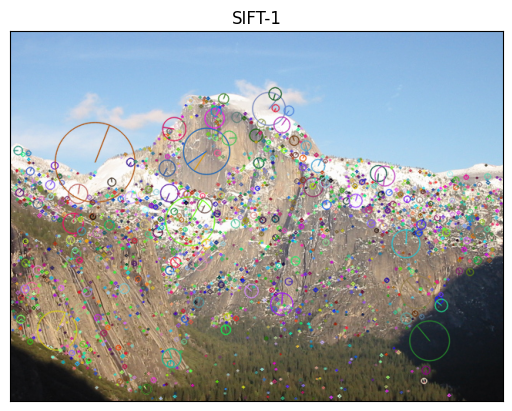

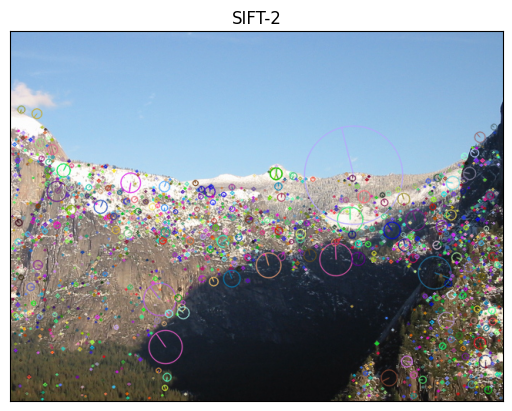

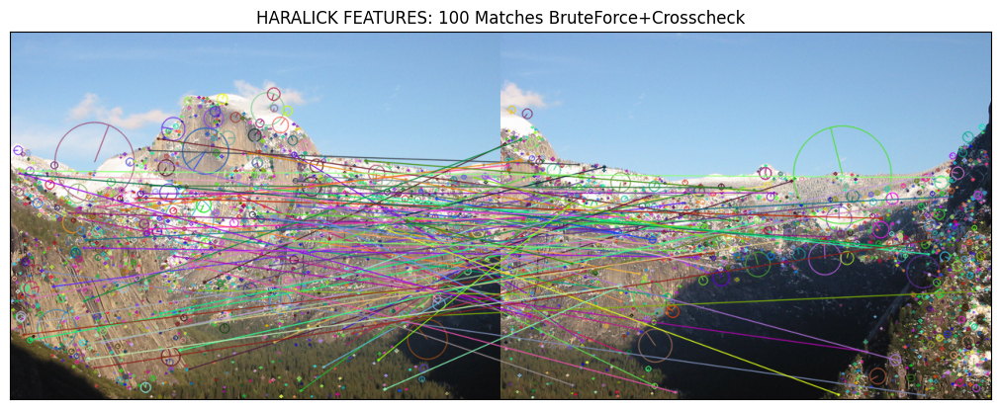

In [21]:
# Leer dos imágenes y convertirlas a escala de grises
img1 = readIm(get_image('yosemite2.jpg'), 1)
im1 = cv2.cvtColor(img1, cv2.COLOR_RGB2GRAY)

img2 = readIm(get_image('yosemite3.jpg'), 1)
im2 = cv2.cvtColor(img2, cv2.COLOR_RGB2GRAY)

# Detectar keypoints para ambas imágenes en escala de grises
kp1, _ = siftPoints(im1)
kp2, _ = siftPoints(im2)

# Mostrar los keypoints detectados en ambas imágenes a color
showKP(img1, kp1, 'SIFT-1')
showKP(img2, kp2, 'SIFT-2')

# Calcular los descriptores de Haralick para ambas imágenes en escala de grises
haralickDs1 = computeHaralickFeatures(im1, kp1)
haralickDs2 = computeHaralickFeatures(im2, kp2)

# Emparejar los descriptores de Haralick entre las dos imágenes usando Brute-Force con crossCheck
haralickMatchesBF = matching(haralickDs1, haralickDs2, 'BF')

# Mostrar los N primeros emparejamientos entre ambas imágenes a color
N = 100
showMatches(img1, kp1, img2, kp2, haralickMatchesBF, N, title='HARALICK FEATURES: 100 Matches BruteForce+Crosscheck')

Observamos que tenemos un emparejamiento muy malo. Ocurre todo lo contrario a los emparejamientos que se daban con los descriptores de SIFT. Vemos que las líneas que conectan los puntos clave entre las dos imágenes no son consistentes en términos de dirección y flujo (es decir, las líneas se cruzan de manera significativa y no siguen la geometría natural de la escena).

Se observan emparejamientos donde las líneas conectan puntos que obviamente no son correspondientes, como, por ejemplo, conectar el borde de la montaña de una imagen con el bosque en la otra.

Visualmente, vemos que los puntos emparejados no son correctos en absoluto.

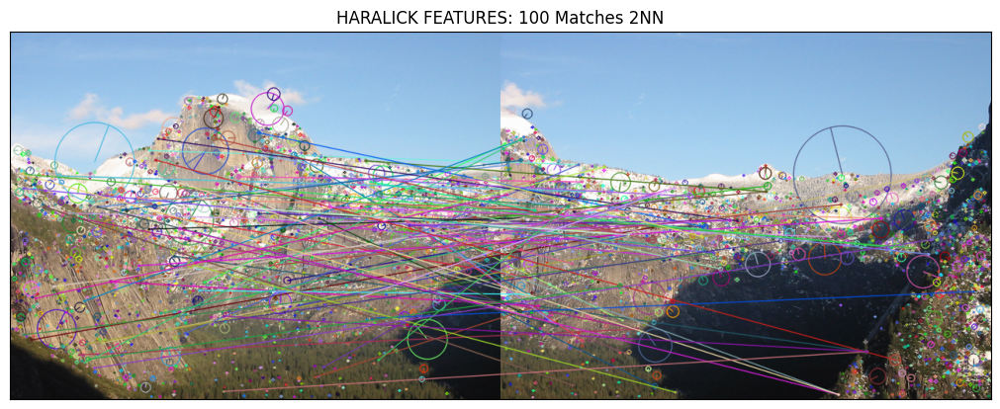

In [22]:
# Emparejar los descriptores de Haralick entre las dos imágenes usando KNN con K = 2
haralickMatches2NN = matching(haralickDs1, haralickDs2, 'KNN')

# Mostrar los N primeros emparejamientos entre ambas imágenes a color
N = 100
showMatches(img1, kp1, img2, kp2, haralickMatches2NN, N, title='HARALICK FEATURES: 100 Matches 2NN')

Por la misma explicación dada anteriormente para el caso de matching de Brute-Force + Cross-Check con los descriptores de Haralick, concluímos que también se producen emparejamientos incorrectos en el caso de matching 2NN con el test de ratio de Lowe.

<font color='blue'> Which feature descriptor seems to be more suitable for keypoint matching? Why?

Observamos que, en base a los resultados obtenidos, **los descriptores de SIFT son mucho más adecuados que los descriptores de Haralick para keypoint matching.**

En general, SIFT es más adecuado para el emparejamiento de puntos clave, especialmente en escenarios que involucran imágenes de paisajes o escenas naturales con variaciones significativas en escala, rotación e iluminación. Esto se debe a que, como ya comentamos anteriormente, SIFT está diseñado específicamente para ser robusto a tales cambios. Identifica puntos clave y calcula descriptores que son invariantes a la escala de la imagen y la rotación, y robustos a los cambios en la iluminación y el punto de vista de la cámara 3D.

Por otro lado, los descriptores de Haralick son descriptores de textura calculados a partir de la matriz de co-ocurrencia de una imagen y describen la textura de la región que rodea un punto clave. Mientras que los descriptores de Haralick pueden ser poderosos para analizar patrones de textura y diferenciar entre regiones texturizadas dentro de la misma imagen, no son inherentemente invariantes a la escala o la rotación y pueden no ser tan robustos a los cambios en la iluminación o el punto de vista. Esto los hace menos adecuados para emparejar puntos clave entre imágenes donde la escena u objeto ha sufrido transformaciones o cambios en la configuración de la cámara.

En conclusión, para el emparejamiento de puntos clave entre imágenes donde es probable que haya diferencias en el punto de vista, escala o rotación, SIFT suele ser más efectivo. Los descriptores de Haralick podrían ser más beneficiosos en aplicaciones donde la clasificación de texturas dentro de la misma escala y orientación es la principal preocupación.

# <font color='blue'>**Exercise 4:** Image Stitching using Homographies (3 points)

<font color='blue'>Now we are going to compute homographies between images, and use them to build a mosaic/panorama. To calculate the homography between two images, call the function `cv2.findHomography()`, which takes as input the lists of KeyPoints and the matches found between them. Use RANSAC to perform a robust estimation.

Este ejercicio se enfoca en el **cálculo de homografías** y la **composición de un mosaico o panorama** a partir de varias imágenes. La creación de un panorama implica combinar múltiples imágenes parcialmente superpuestas para producir una imagen panorámica o de alta resolución. Las homografías permiten mapear puntos de una imagen a otra. El proceso general incluye la detección y el emparejamiento de puntos clave entre imágenes (lo cual ya hicimos en el ejercicio 3), la estimación de homografías usando DLT y RANSAC, y finalmente la aplicación de estas homografías para alinear y unir las imágenes en un mosaico. Es crucial elegir adecuadamente la imagen central y calcular correctamente las homografías para obtener un mosaico de alta calidad.

Una **homografía** (o mapa en perspectiva plana) es una transformación proyectiva que relaciona dos planos de imágenes y se utiliza para mapear puntos correspondientes entre dos vistas de una escena. Se representa mediante una matriz 3x3 pero con 8 grados de libertad, lo cual hace que para estimar una homografía se necesitan como mínimo cuatro keypoints emparejados (cada emparejamiento resuelve dos restricciones), aunque en general se disponen de muchos más emparejamientos para poder construir una homografía. Es una matriz proyectiva que asigna un plano a otro plano (pero lo asigna a través de un punto), de forma que si nuestras imágenes comparten el mismo centro de proyección (también llamado centro de cámara), podemos asignar todas las imágenes a un solo plano calculando las homografías entre las imágenes.

$$\begin{equation}
\begin{pmatrix}
a & b & c\\
d & e & f\\
g & h & i
\end{pmatrix}
\end{equation}$$

Es especialmente útil en Visión por Computador y la fotogrametría para casos como la creación de panoramas, donde se alinean y combinan varias imágenes. Podemos pensar en ellas como una generalización de las **transformaciones afines**, las cuales también se representan mediante una matriz 3x3 y son combinaciones de translaciones y transformaciones lineales (escala, rotación, corte y espejo).


$$\begin{equation}
\begin{pmatrix}
a & b & c\\
d & e & f\\
0 & 0 & 1
\end{pmatrix}
\end{equation}$$

En términos matriciales, vemos que la diferencia entre las transformaciones afines y las homografías es que la tercera fila de la matriz de una transformación afín es $(0\ 0\ 1)$ mientras que en las homografías esta fila puede tomar cualquier valor $(g\ h\ i)$. Esto hace que, tras las transformaciones afines, las líneas paralelas se mantengan paralelas mientras que, tras las homografías, esto no tiene que ser así necesariamente.

Por otro lado, como ya hemos comentado, para la estimación de las homografías usaremos **RANSAC (Random Sample Consensus)** es un método robusto para estimar parámetros de un modelo matemático a partir de un conjunto de datos observados que contiene valores atípicos (outliers). La técnica se basa en seleccionar al azar un subconjunto de los datos originales, ajustar el modelo a estos puntos y luego determinar cuántos del conjunto completo de datos se ajustan a este modelo (inliers). Este proceso se repite con diferentes subconjuntos aleatorios, y el modelo con el mayor número de inliers es seleccionado como el mejor.

In [23]:
# Función para calcular una homografía
def homography(kp1, kp2, matches, Ransac_Error, MIN_MATCH_COUNT=20):
  # Homografía
  H = None

  # Verificar si el número de matches es mayor que el mínimo requerido para una homografía confiable
  if len(matches) > MIN_MATCH_COUNT:
    # Extraer las ubicaciones de los keypoints coincidentes de ambas imágenes
    srcPts = np.float32([kp1[m.queryIdx].pt for m in matches]).reshape(-1, 1, 2)   # "queryIdx" se refiere a los keypoints en la primera imagen
    dstPts = np.float32([kp2[m.trainIdx].pt for m in matches]).reshape(-1, 1, 2)   # "trainIdx" se refiere a los keypoints en la segunda imagen

    # Calcular la homografía usando RANSAC
    H, _ = cv2.findHomography(srcPts, dstPts, cv2.RANSAC, Ransac_Error)
  else:
    # Si no se tienen suficientes matches, imprimir un mensaje de error
    print('Error - very few matches')
  return H

Caben destacar dos **ideas principales** para la realización de este ejercicio:

1. **Composición de homografías**: La transformación a aplicar puede ser la composición de varias homografías, y cuantas más homografías haya, más se deformará la imagen. Por ello, debemos intentar combinar la menor cantidad de homografías posible, de forma que **deberíamos ir de los extremos a la imagen central, y no de un extremo al otro.**

2. **Rellenar el canvas**: Deberíamos intentar conseguir el mosaico de mayor calidad posible. Por tanto, **debemos “pegar” las imágenes de los extremos/límites al centro del lienzo, y pegar, como última imagen, la imagen central**(que sólo requerirá una translación)

**NOTA: La "imagen central" no tiene que ser necesariamente la que esté en el centro (de la lista ordenada de fotos)**. Imaginemos, por ejemplo, que al tomar fotos de izquierda a derecha, hay muchas más fotos en un lado que en el otro. En ese caso, el mosaico estaría más distorsionado en el lado con menos fotos.

<font color='blue'>To compose the mosaic we need to provide the following information:

> <font color='blue'>a) Maximum size of the canvas according to the number of images to be stitched and their dimensions.

> <font color='blue'>b) The central image that will give the axes to the mosaic.

> <font color='blue'>c) The order of each image with respect to the central one (i.e., we know the position of each image in the burst of images taken).

> <font color='blue'>d) The homography to copy the central image into the canvas.

<font color='blue'>Now, once all the aforementioned decisions have been made, we need to proceed as follows:
> <font color='blue'>a) Read the images from left to right.

> <font color='blue'>b) Set one central image as the reference to create the panorama. This one will provide the axes to the canvas.

> <font color='blue'>c) Compute the homography between each two consecutive images in your list.

> <font color='blue'>d) Set the canvas and the reference homography.

> <font color='blue'>e) Compute the homography between each image and the canvas.

> <font color='blue'>f) Use the computed homographies to transport the images to the canvas. Use the function `cv2. warpPerspective()`.

> <font color='blue'>g) Remove the black regions from the canvas to improve quality.



En el código que viene a continuación, implementamos todas las funciones necesarias para poder realizar la composición del mosaico siguiendo los pasos mencionados en el enunciado anterior. Cabe destacar el uso de las siguientes funciones de OpenCV para la realización de este ejercicio:

- `cv2.findHomography()` con `cv2.RANSAC` como uno de sus parámetros, usada para estimar la homografía entre dos imágenes a partir de sus keypoints emparejados.

[14] https://docs.opencv.org/3.4/d9/d0c/group__calib3d.html#ga4abc2ece9fab9398f2e560d53c8c9780

- `cv2.warpPerspective()` con `cv2.BORDER_TRANSPARENT` como uno de sus parámetros, usada para componer el mosaico, transportando las imágenes al canvas usando las homografías calculadas.

[15] https://docs.opencv.org/4.x/da/d54/group__imgproc__transform.html#gaf73673a7e8e18ec6963e3774e6a94b87

- `cv2.boundingRect()`, usada en la función `blackOut()` para mejorar la calidad final del panorama resultante, eliminando las bandas negras sobrantes.

[16] https://docs.opencv.org/4.x/dd/d49/tutorial_py_contour_features.html

In [24]:
# Función para calcular las homografías entre cada dos imágenes consecutivas
def computeLocalHomographies(images, method='KNN', Ransac_Error=5.0):
  # Lista de homografías
  H = []

  for i in range(0, len(images)-1):
    # Keypoints y descriptores SIFT para la imagen i
    kp1, ds1 = siftPoints(images[i])
    # Keypoints y descriptores SIFT para la imagen i+1 (imagen siguiente)
    kp2, ds2 = siftPoints(images[i+1])

    # Matches entre los descriptores de las dos imágenes
    matches = matching(ds1, ds2, FlagMode=method)

    # Homografía entre las dos imágenes basándose en los matches
    localH = homography(kp1, kp2, matches, Ransac_Error)

    # Añadir la homografía calculada a la lista de homografías
    H.append(localH)

  return H

# Función para calcular la homografía de cada imagen al canvas
# idx en este caso es la imagen central
def mosaicHomographies(H, idx):
  # Invertir las homografías para las imágenes a la derecha de la imagen central
  for i in range(idx, len(H)):
    H[i] = np.linalg.inv(H[i])

  # Calcular las homografías acumulativas para las imágenes a la derecha de la central
  for i in range(idx+1, len(H)):
    H[i] = H[i-1] @ H[i]     # Multiplicar la homografía acumulada actual con la homografía siguiente en la secuencia

  # Calcula las homografías acumulativas para las imágenes a la izquierda de la central
  for i in range(idx-2, -1, -1):
    H[i] = H[i+1] @ H[i]     # Multiplicar la homografía acumulada actual con la homografía anterior en la secuencia

  return H

# Función para calcular la homografía de la imagen central al canvas
# Esta homografía desplaza la imagen central para que esté ubicada en el centro del canvas
def axesHomography(sizeim, sizecanvas):
  # Inicializar una matriz de homografía como la matriz identidad
  H = np.eye(3)

  # Calcular el desplazamiento necesario en el eje X (horizontal) para centrar la imagen en el canvas
  H[0,2] = (sizecanvas[1] // 2) - (sizeim[1] // 2)

  # Calcular el desplazamiento necesario en el eje Y (vertical) para centrar la imagen en el canvas
  H[1,2] = (sizecanvas[0] // 2) - (sizeim[0] // 2)

  return H

In [25]:
# Funciones auxiliares

# Esta función define y devuelve el canvas
def setCanvas(row, col, flagColor, nim=2):
  # Calcular el número de filas y columnas del lienzo multiplicando los valores dados
  # por "nim", que es un factor de escala para ajustar el tamaño del lienzo
  rows = row * nim
  cols = col * nim

  # Si flagColor es True, se crea un lienzo en color (3 canales)
  if flagColor:
    return np.zeros((rows, cols, 3), np.uint8)
  # Si flagColor es False, se crea un lienzo en escala de grises (1 canal)
  else:
    return np.zeros((rows, cols), np.uint8)

# Función para eliminar los píxeles redundantes del canvas
def blackOut(img, offset=0):
  # Si la imagen es a color (tiene 3 canales)
  if len(img.shape) == 3:
    # Convertir la imagen a escala de grises para simplificar la detección de píxeles no negros
    im = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)

    # Crear una máscara binaria donde los píxeles no negros son marcados con 1 (True)
    mask = np.array((im > 0), np.uint8)

    # Encontrar el rectángulo delimitador más pequeño que contiene todos los píxeles no negros
    x, y, w, h = cv2.boundingRect(mask)

    # Recortar la imagen a color para eliminar las regiones negras, aplicando un offset si es necesario, y devolverla
    return img[y+offset:y+h-offset, x+offset:x+w-offset, :]
  # Si la imagen no es a color (es en escala de grises)
  else:
    # Crear una máscara binaria donde los píxeles no negros son marcados con 1 (True)
    mask = np.array((img > 0), np.uint8)

    # Encontrar el rectángulo delimitador más pequeño que contiene todos los píxeles no negros
    x, y, w, h = cv2.boundingRect(mask)

    # Recortar la imagen a color para eliminar las regiones negras, aplicando un offset si es necesario, y devolverla
    return img[y+offset:y+h-offset, x+offset:x+w-offset]

In [26]:
# Función para componer el mosaico
def composeMosaic(images, canvas, H, idxc, H0):
  # Obtener las dimensiones del canvas
  rows = canvas.shape[0]
  cols = canvas.shape[1]

  # Contador para las homografías
  contadorH = 0
  # Colocar en el canvas las imágenes que están a la izquierda de la imagen central
  for i in range(0, idxc):
    canvas = cv2.warpPerspective(images[i], H0 @ H[contadorH], (cols, rows), dst=canvas, flags=cv2.INTER_CUBIC, borderMode=cv2.BORDER_TRANSPARENT)
    contadorH += 1

  # Colocar la imagen central en el canvas usando la homografía base H0
  canvas = cv2.warpPerspective(images[idxc], H0, (cols, rows), dst=canvas, flags=cv2.INTER_CUBIC, borderMode=cv2.BORDER_TRANSPARENT)

  # Reajustar el contador para las homografías
  contadorH = len(H) - 1
  # Colocar en el canvas las imágenes que están a la derecha de la imagen central
  for i in range(len(images)-1, idxc, -1):
    canvas = cv2.warpPerspective(images[i], H0 @ H[contadorH], (cols, rows), dst=canvas, flags=cv2.INTER_CUBIC, borderMode=cv2.BORDER_TRANSPARENT)
    contadorH -= 1

  return canvas

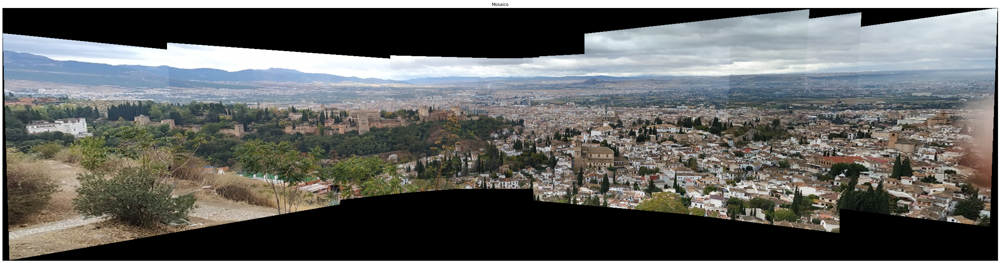

In [27]:
# Lista para almacenar las imágenes que formarán parte del mosaico
images = []

# Construcción de mosaico: Movimiento de cámara de izquierda a derecha

# Prefijo y directorio de las imágenes
PREFIX = 'IMG_20211030_1104'
DIR = ''
# Lista de nombres de imágenes para construir el mosaico
nameImages = ['10_S.jpg', '13_S.jpg', '15_S.jpg', '17_S.jpg', '18_S.jpg', '20_S.jpg',
              '21_S.jpg', '25_S.jpg', '26_S.jpg', '28_S.jpg', '31_S.jpg', '33_S.jpg',
              '34_S.jpg', '36_S.jpg']

# Leer las imágenes y añadirlas a la lista "images"
for item in nameImages:
  images.append(readIm(get_image(PREFIX+item), flagColor=1))

# Índice de la imagen que será el centro del mosaico
idImCentral = 5

# Calcular las homografías locales entre cada par de imágenes consecutivas
H = computeLocalHomographies(images)

# Calcular las homografías desde cada imagen hasta la imagen central del mosaico
H = mosaicHomographies(H, idImCentral)

# Definir y crear el canvas donde se construirá el mosaico
dimensions = [img.shape[:2] for img in images]    # Lista con las dimensiones (ancho y alto) de cada imagen

row, col = np.amax(dimensions, axis=0)            # Dimensiones máximas

canvas = setCanvas(row, col, flagColor=True, nim=len(images))

# Calcular la homografía base (H0) para centrar la imagen central en el canvas
canvasRows = row * len(images)
canvasCols = col * len(images)

H0 = axesHomography(images[idImCentral].shape[:2], (canvasRows, canvasCols))

# Componer el mosaico utilizando las imágenes, el canvas y las homografías calculadas
mosaic = composeMosaic(images, canvas, H, idImCentral, H0)

# Mostrar el mosaico final, eliminando los píxeles redundantes del canvas
displayIm(blackOut(mosaic), 'Mosaico', 8)

Observamos que obtenemos el resultado esperado, a partir de diferentes imágenes del mismo paisaje donde cada imagen se ha realizado desplazando la camará cada vez un poco más a la derecha (partiendo desde la izquierda), hemos conseguido crear una imagen panorámica (un mosaico) donde se aprecia el paisaje perfectamente.

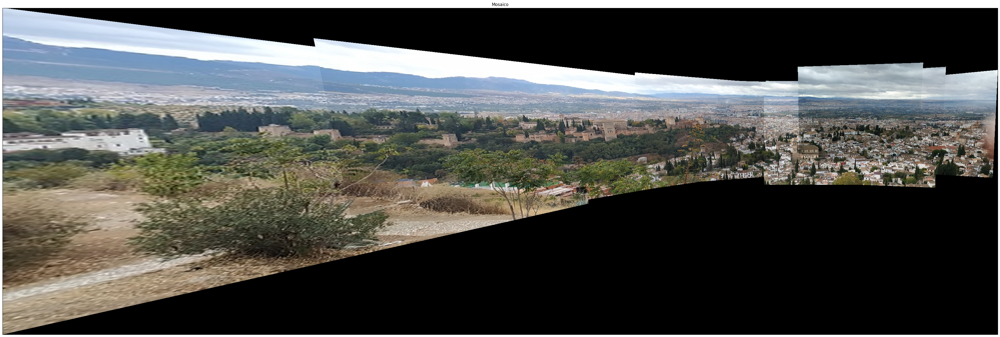

In [28]:
# Índice de la imagen que será el centro del mosaico
idImCentral = 9

# Calcular las homografías locales entre cada par de imágenes consecutivas
H = computeLocalHomographies(images)

# Calcular las homografías desde cada imagen hasta la imagen central del mosaico
H = mosaicHomographies(H, idImCentral)

# Definir y crear el canvas donde se construirá el mosaico
dimensions = [img.shape[:2] for img in images]    # Lista con las dimensiones (ancho y alto) de cada imagen

row, col = np.amax(dimensions, axis=0)            # Dimensiones máximas

canvas = setCanvas(row, col, flagColor=True, nim=len(images))

# Calcular la homografía base (H0) para centrar la imagen central en el canvas
canvasRows = row * len(images)
canvasCols = col * len(images)

H0 = axesHomography(images[idImCentral].shape[:2], (canvasRows, canvasCols))

# Componer el mosaico utilizando las imágenes, el canvas y las homografías calculadas
mosaic = composeMosaic(images, canvas, H, idImCentral, H0)

# Mostrar el mosaico final, eliminando los píxeles redundantes del canvas
displayIm(blackOut(mosaic), 'Mosaico', 8)

Aquí hacemos destacar el comentario que ya realizamos anteriormente: **la importancia de una buena elección de la imagen central**. Nótese como las imágenes de la izquierda aparecen mucho más estiradas/deformadas debido a que, como ya se comentó anteriormente, cuantas más homografías se apliquen, mayores deformaciones obtendremos. Por ello, siempre debemos probar con diferentes elecciones de imagen central y ver con cuál obtenemos el mejor resultado.